# Data Exploration

## Kaggle Home Credit Default Risk Competition

https://www.kaggle.com/c/home-credit-default-risk

This competition is sponsored by [Home Credit](http://www.homecredit.net), whose mission is to provide a positive and safe borrowing experience to groups of people that traditional, mainstream banks and financial institutions typically refuse to serve.

In order to make lending decisions on applicants from this demographic, Home Credit needs an algorithm that will take as inputs various financial and personal information originally taken from a loan applicant's profile, and then compute a probability that the applicant will have trouble paying back the loan. This probability will be in the range [0.0, 1.0], where 1.0 represents a 100% certainty that the applicant will have repayment difficulties and 0.0 indicates that there is zero chance that the applicant will ever miss any payments. The algorithm will be tested and ranked on Kaggle based on a set predictions it makes for 48,744 individuals who previously borrowed from Home Credit.

Solution algorithms will be trained on a set of datapoints from 307,511 previous Home Credit borrowers. It is imperative that some portion, say 20%, of the training set is set aside to serve as a validation set. Alternatively, an algorithm such as K-Fold Cross Validation could be used.

To submit a solution on Kaggle, a CSV file must be produced that contains one header row, and 48,744 prediction rows, where each prediction row contains both a user ID, the `SKI_ID_CURR` column, and the probability, the `TARGET` column, of that user having repayment defficulties. The file must be formatted as follows:

    SK_ID_CURR,TARGET
    100001,0.1
    100005,0.9
    100013,0.2
    etc.
    
Home Credit knows which borrowers in the test set were delinquent, and which ones never made a late payment. A good algorithm will need to predict a high probability of delinquent repayment for the majority of borrowers who did in fact make late payments (those whose `TARGET` value is 1 in the main table in the dataset). This algorithm will also need to predict a low probability of delinquent repayment for the majority of borrowers who never made a late payment (those whose `TARGET` value is 0 in the main table in the dataset).

In [4]:
# Import libraries necessary for this project.
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

# Import supplementary visualizations code visuals.py
import visuals as vs

# Display matplotlib plots inline in this notebook.
%matplotlib inline
# Make plots display well on retina displays
%config InlineBackend.figure_format = 'retina'
# Set dpi of plots displayed inline
mpl.rcParams['figure.dpi'] = 300
# Configure style of plots
plt.style.use('fivethirtyeight')
# Make plots smaller
sns.set_context('paper')  

# Allows the use of display() for dataframes.
from IPython.display import display
# Have all columns appear when dataframes are displayed.
pd.set_option('display.max_columns', None) 
# Have 100 rows appear when a dataframe is displayed
pd.set_option('display.max_rows', 500)
# Display dimensions whenever a dataframe is printed out.
pd.set_option('display.show_dimensions', True)

### Data Table Description

From https://www.kaggle.com/c/home-credit-default-risk/data:

1. **application_{train|test}.csv**
   * This is the main table, broken into two files for Train (with TARGET) and Test (without TARGET).
   * Static data for all applications. One row represents one loan in our data sample.
<p>
<p>
* **bureau.csv**
   * All client's previous credits provided by other financial institutions that were reported to Credit Bureau (for clients who have a loan in our sample).
   * For every loan in our sample, there are as many rows as number of credits the client had in Credit Bureau before the application date.
<p>
<p>
* **bureau_balance.csv**

  * Monthly balances of previous credits in Credit Bureau.
  * This table has one row for each month of history of every previous credit reported to Credit Bureau – i.e the table has (#loans in sample * # of relative previous credits * # of months where we have some history observable for the previous credits) rows.
<p>
<p>
* **previous_application.csv**

  * All previous applications for Home Credit loans of clients who have loans in our sample.
  * There is one row for each previous application related to loans in our data sample.
<p>
<p>
* **POS_CASH_balance.csv**

  * Monthly balance snapshots of previous POS (point of sales) and cash loans that the applicant had with Home Credit.
  * This table has one row for each month of history of every previous credit in Home Credit (consumer credit and cash loans) related to loans in our sample – i.e. the table has (#loans in sample * # of relative previous credits * # of months in which we have some history observable for the previous credits) rows.
<p>
<p>
* **installments_payments.csv**

  * Repayment history for the previously disbursed credits in Home Credit related to the loans in our sample.
  * There is a) one row for every payment that was made plus b) one row each for missed payment.
  * One row is equivalent to one payment of one installment OR one installment corresponding to one payment of one previous Home Credit credit related to loans in our sample.
<p>
<p>
* **credit_card_balance.csv**

  * Monthly balance snapshots of previous credit cards that the applicant has with Home Credit.
  * This table has one row for each month of history of every previous credit in Home Credit (consumer credit and cash loans) related to loans in our sample – i.e. the table has (#loans in sample * # of relative previous credit cards * # of months where we have some history observable for the previous credit card) rows.

![Data Table Diagram](images/homecredit.png "Data Table Diagram")

In [5]:
# Load the main data tables
application_train_data = pd.read_csv("data/application_train.csv")
application_test_data = pd.read_csv("data/application_test.csv")

In [4]:
# Load the Bureau data table
bureau_data = pd.read_csv("data/bureau.csv")

In [3]:
# Load all other data tables
bureau_balance_data = pd.read_csv("data/bureau_balance.csv")
previous_application_data = pd.read_csv("data/previous_application.csv")
POS_CASH_balance_data = pd.read_csv("data/POS_CASH_balance.csv")
installments_payments_data = pd.read_csv("data/installments_payments.csv")


In [2]:
credit_card_balance_data = pd.read_csv("data/credit_card_balance.csv")

# 1. Main Data Table (`application_{train|test}.csv`)

In [53]:
# Total number of entries in training group
print("Total number of entries in training group: {}".format(application_train_data.shape[0]))

Total number of entries in training group: 307511


In [54]:
# Total number of entries in test group
print("Total number of entries in test group: {}".format(application_test_data.shape[0]))

Total number of entries in test group: 48744


In [55]:
# Total number of features in the main (application) data table
print("Total number of features in main (application) data table: {}".format(application_train_data.shape[1]))

Total number of features in main (application) data table: 122


The first two features in the main data table training group, `SK_ID_CURR` and `TARGET`, represent the borrower's ID number and target data (whether or not they made at least one late payment), respectively.

There are therefore 120 features in the main data table that can be used to predict a borrowers' targets.

In [56]:
# Display the first 500 records
display(application_train_data.head(n=500))

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.000,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.0000,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.0220,0.0198,0.0000,0.0000,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.0000,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.000,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.0800,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.0790,0.0554,0.0000,0.0000,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.0100,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.000,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [187]:
# Display the above statistical description table, but with axes inverted, so that the table can 
# be included in the project's writeup.
display(application_train_data.describe().transpose())

,count,mean,std,min,25%,50%,75%,max
SK_ID_CURR,307511.0,278180.518577,102790.175348,1.000020e+05,189145.500000,278202.000000,367142.500000,4.562550e+05
TARGET,307511.0,0.080729,0.272419,0.000000e+00,0.000000,0.000000,0.000000,1.000000e+00
CNT_CHILDREN,307511.0,0.417052,0.722121,0.000000e+00,0.000000,0.000000,1.000000,1.900000e+01
AMT_INCOME_TOTAL,307511.0,168797.919297,237123.146279,2.565000e+04,112500.000000,147150.000000,202500.000000,1.170000e+08
AMT_CREDIT,307511.0,599025.999706,402490.776996,4.500000e+04,270000.000000,513531.000000,808650.000000,4.050000e+06
AMT_ANNUITY,307499.0,27108.573909,14493.737315,1.615500e+03,16524.000000,24903.000000,34596.000000,2.580255e+05
AMT_GOODS_PRICE,307233.0,538396.207429,369446.460540,4.050000e+04,238500.000000,450000.000000,679500.000000,4.050000e+06
REGION_POPULATION_RELATIVE,307511.0,0.020868,0.013831,2.900000e-04,0.010006,0.018850,0.028663,7.250800e-02
DAYS_BIRTH,307511.0,-16036.995067,4363.988632,-2.522900e+04,-19682.000000,-15750.000000,-12413.000000,-7.489000e+03
DAYS_EMPLOYED,307511.0,63815.045904,141275.766519,-1.791200e+04,-2760.000000,-1213.000000,-289.000000,3.652430e+05


In [59]:
# Count number of delinquent repayers ('TARGET' value of 1) and non-delinquent repayers 
# ('TARGET' value of 0) in the training set of the main data table.

application_train_data['TARGET'].value_counts()

0    282686
1     24825
Name: TARGET, Length: 2, dtype: int64

In [60]:
# Fraction of applicants in training set who were delinquent repayers. If you took a random 
# sample, this is the probability you would select a delinquent repayer by chance:
repayers_fraction = round(24825/(24825+282686), 4)
print('Fraction of training set who were delinquent payers: {}'.format(repayers_fraction))

Fraction of training set who were delinquent payers: 0.0807


### Main Data Table Features with 'NaN' Entries

Do any features have mostly 'NaN' for their entries -- are any features too sparse to be of use?

In [62]:
# Get numerical counts of number of NaN entries in each column (feature) in the main data table.
features_sorted_by_NaN_count = application_train_data.isnull().sum().sort_values(ascending=False)

# Display only features with NaN counts greater than 0.
feature_NaN_counts = features_sorted_by_NaN_count[features_sorted_by_NaN_count > 0]

# Create a dataframe to summarize 'NaN' entries of features in the main data table (application_train_data)
feature_NaN_summary = pd.DataFrame(index=feature_NaN_counts.index, columns=['#_NaN_Entries','Fraction_of_entries_that_are_NaN','#_NaN_entries_who_are_Delinquent','Fraction_of_NaN_entries_who_are_Delinquent','#non_NaN_Entries','#non_NaN_entries_who_are_Delinquent','Fraction_of_non_NaN_entries_who_are_Delinquent'])

# Fill each row in the NaN summary dataframe
for feature_name in feature_NaN_summary.index:
    # Get the amount and fraction of delinquents among all borrowers who 
    # have an 'NaN' entry for a particular feature. Do this for each feature that has at least 
    # one 'NaN' entry.
    number_of_NaN = feature_NaN_counts.loc[feature_name]
    feature_NaN_summary['#_NaN_Entries'][feature_name] = number_of_NaN
    number_delinquents_who_are_NaN = application_train_data[(application_train_data[feature_name].isnull()) & (application_train_data['TARGET'] == 1)].shape[0]
    feature_NaN_summary['#_NaN_entries_who_are_Delinquent'][feature_name] = number_delinquents_who_are_NaN
    fraction_of_NaN_entries_who_are_delinquents = round(number_delinquents_who_are_NaN/number_of_NaN,4)
    feature_NaN_summary['Fraction_of_NaN_entries_who_are_Delinquent'][feature_name] = fraction_of_NaN_entries_who_are_delinquents
    
    # Get the amount of non-'NaN' entries in each feature that 
    # has at least one 'NaN' entry.
    number_of_records = application_train_data[feature_name].shape[0]
    number_of_non_NaN = number_of_records - number_of_NaN
    feature_NaN_summary['#non_NaN_Entries'][feature_name] = number_of_non_NaN
    
    # Get the fraction of the total entries for a feature that are 'NaN'
    fraction_of_feature_entries_that_are_NaN = round(number_of_NaN/(number_of_NaN+number_of_non_NaN),4)
    feature_NaN_summary['Fraction_of_entries_that_are_NaN'][feature_name] = fraction_of_feature_entries_that_are_NaN
    
    # Get the amount and fraction of delinquents among all borrowers who 
    # have a non-'NaN' entry for a particular feature. Do this for each feature that has at least 
    # one 'NaN' entry.
    number_delinquents_who_are_not_NaN = application_train_data[(application_train_data[feature_name].notnull()) & (application_train_data['TARGET'] == 1)].shape[0]
    feature_NaN_summary['#non_NaN_entries_who_are_Delinquent'][feature_name] = number_delinquents_who_are_not_NaN
    fraction_of_non_NaN_entries_who_are_delinquents = round(number_delinquents_who_are_not_NaN/number_of_non_NaN,4)
    feature_NaN_summary['Fraction_of_non_NaN_entries_who_are_Delinquent'][feature_name] = fraction_of_NaN_entries_who_are_delinquents

# Display the NaN summary dataframe below
display(feature_NaN_summary, 'display.max_columns')

,#_NaN_Entries,Fraction_of_entries_that_are_NaN,#_NaN_entries_who_are_Delinquent,Fraction_of_NaN_entries_who_are_Delinquent,#non_NaN_Entries,#non_NaN_entries_who_are_Delinquent,Fraction_of_non_NaN_entries_who_are_Delinquent
COMMONAREA_MEDI,214865,0.6987,18423,0.0857,92646,6402,0.0857
COMMONAREA_AVG,214865,0.6987,18423,0.0857,92646,6402,0.0857
COMMONAREA_MODE,214865,0.6987,18423,0.0857,92646,6402,0.0857
NONLIVINGAPARTMENTS_MODE,213514,0.6943,18327,0.0858,93997,6498,0.0858
NONLIVINGAPARTMENTS_MEDI,213514,0.6943,18327,0.0858,93997,6498,0.0858
NONLIVINGAPARTMENTS_AVG,213514,0.6943,18327,0.0858,93997,6498,0.0858
FONDKAPREMONT_MODE,210295,0.6839,18125,0.0862,97216,6700,0.0862
LIVINGAPARTMENTS_MEDI,210199,0.6835,18122,0.0862,97312,6703,0.0862
LIVINGAPARTMENTS_MODE,210199,0.6835,18122,0.0862,97312,6703,0.0862
LIVINGAPARTMENTS_AVG,210199,0.6835,18122,0.0862,97312,6703,0.0862


'display.max_columns'

In [68]:
print(feature_NaN_summary.sort_values(by=['#_NaN_Entries'], ascending=False).index.values.tolist())

['COMMONAREA_MEDI', 'COMMONAREA_MODE', 'COMMONAREA_AVG', 'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAPARTMENTS_MEDI', 'NONLIVINGAPARTMENTS_AVG', 'FONDKAPREMONT_MODE', 'LIVINGAPARTMENTS_MEDI', 'LIVINGAPARTMENTS_MODE', 'LIVINGAPARTMENTS_AVG', 'FLOORSMIN_MEDI', 'FLOORSMIN_MODE', 'FLOORSMIN_AVG', 'YEARS_BUILD_MEDI', 'YEARS_BUILD_AVG', 'YEARS_BUILD_MODE', 'OWN_CAR_AGE', 'LANDAREA_AVG', 'LANDAREA_MEDI', 'LANDAREA_MODE', 'BASEMENTAREA_MEDI', 'BASEMENTAREA_AVG', 'BASEMENTAREA_MODE', 'EXT_SOURCE_1', 'NONLIVINGAREA_MEDI', 'NONLIVINGAREA_AVG', 'NONLIVINGAREA_MODE', 'ELEVATORS_MODE', 'ELEVATORS_AVG', 'ELEVATORS_MEDI', 'WALLSMATERIAL_MODE', 'APARTMENTS_AVG', 'APARTMENTS_MEDI', 'APARTMENTS_MODE', 'ENTRANCES_MODE', 'ENTRANCES_AVG', 'ENTRANCES_MEDI', 'LIVINGAREA_MEDI', 'LIVINGAREA_MODE', 'LIVINGAREA_AVG', 'HOUSETYPE_MODE', 'FLOORSMAX_AVG', 'FLOORSMAX_MODE', 'FLOORSMAX_MEDI', 'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BEGINEXPLUATATION_MODE', 'TOTALAREA_MODE', 'EMERGENCYSTATE_MODE

The goal of creating the above summary of all 'NaN' entries in the main data table was to investigate three specific questions concerning these 67 features that each have at least one 'NaN' entry:

1. Whether simply having 'NaN' for a particular feature could help predict whether a borrower was delinquent.
2. Whether certain features with numerous 'NaN' entries would even be useful in predicting whether a borrower was delinquent. I am suspicious that a few of these features, such as `COMMONAREA_MEDI`, may have too few non-'NaN' entries that belong to delinquent payers. If too small a portion of the training set's target segment is included in these features, it's hard to see how they will be useful in making predictions that generalize to unseen datapoints.
3. Do 'NaN' values primarily belong to numerical features, categorical features, or both?

In the case of question `1.`, I can confirm that for all 67 features, a borrower simply having an 'NaN' entry for a feature does not in any way shape or form predict whether the borrower will be more or less likely to be delinquent. I verified this for each feature by looking at the fractions of both its 'NaN' and non-'NaN' cohorts that were delinquents. For each feature, I found that the fraction of 'NaN' borrowers who were delinquent was identical to the fraction of non-'NaN' borrowers who were delinquent. If being 'NaN' for a particular feature were to have any chance of being a meaningful predictor of delinquency, I would have expected these two proportions to have had a stastically significant difference for that feature.

For question `2.`, it's helpful to remember that, as confirmed above, there are 24,825 borrowers in the training dataset who were delinquent repayers (who had a `TARGET` value of 1). Any feature that I retain in spite of its 'NaN' entries needs to still have a large enough amount of non-'NaN' entries that belong to delinquents. If the entire training set's delinquent population is not adequately represented among a particular feature's valid data points, it's unlikely that any predictions meaningfully informed by this feature would generalize well to unseen datapoints. The effective training set size for this feature would be just too small, and my model would be at risk of underfitting.

However, the big question is: what should the cutoff line be? What fraction of the 24,825 delinquent borrowers in the training set need to be captured by a feature's valid data points in order for the feature to have a chance of being useful in making predictions? There is no general rule of thumb that I can use to answer this for each of these features that has 'NaN' values. The short answer is, it depends -- on many factors such as distribution of the feature's valid data, as well as the type of classifier algorithm I'm using. 

This is why for the time being I won't remove *any* of these features -- even features like `COMMONAREA_MEDI` that contain 'NaN' in over two-thirds of their entries. Instead of running detailed statistical analyses on these features' distributions, I will instead experiment with dimensionality reduction algorithms such as PCA and/or feature selection algorithms such as SelectKBest.

If a feature had had, say, 95% of its entries as 'NaN', I probably would have removed it from the dataset at this point. However, since the sparsest features in the main data table still have valid data in just over 30% of their entries, I don't want to prematurely remove a feature that may have a chance, however remote, of possibly contributing to useful predictions.

Finally, to answer question `3.`, I found that all but one of the 46 normalized numerical features contain 'NaN' values. About half of the 21 non-normalized numerical features contain 'NaN' entries. Only 3 out of the 15 categorical features that will need to be one-hot encoded contain 'NaN' entries. None of the already one-hot encoded categorical features contain 'NaN' entries.

### Main Data Table Borrowers with 'NaN' Entries

Do any borrowers have mostly 'NaN' entries for their feature data -- could any datapoints representing borrowers be classified as outliers and removed because their feature data is too sparse?

In [70]:
# Get numerical counts of number of NaN entries in each row (borrower) in the main data table.
borrowers_sorted_by_NaN_count = application_train_data.isnull().sum(axis=1).sort_values(ascending=False)

# Display the number of 'NaN' entries for each borrower (left column 
# is borrower ID, right column is number of 'NaN' entries).
display(borrowers_sorted_by_NaN_count)

133770    61
244833    61
150206    61
69707     61
269786    61
269492    61
116937    61
185713    61
197736    61
87399     60
7077      60
115346    60
201306    60
146561    60
68013     60
53941     60
48839     60
36899     60
54457     60
241006    60
290495    60
127942    60
260125    60
109581    60
266184    60
172595    60
271341    60
258474    60
12087     60
193598    59
177876    59
249616    59
219410    59
74199     59
247473    59
18244     59
261487    59
148096    59
80085     59
53550     59
168835    59
198111    59
3498      59
236260    59
28769     59
286217    59
63325     59
213503    59
39841     59
45043     59
109165    59
215458    59
154667    59
62176     59
299853    59
303509    59
193060    58
50126     58
131669    58
277217    58
113159    58
254163    58
214296    58
49241     58
261513    58
256958    58
143851    58
224619    58
226725    58
26398     58
226384    58
116520    58
3718      58
277969    58
43073     58
3525      58
7730      58

In [72]:
display(borrowers_sorted_by_NaN_count.count())

307511

In [76]:
display(borrowers_sorted_by_NaN_count.map(lambda x: 1 if x >= 54 else 0).sum())

21513

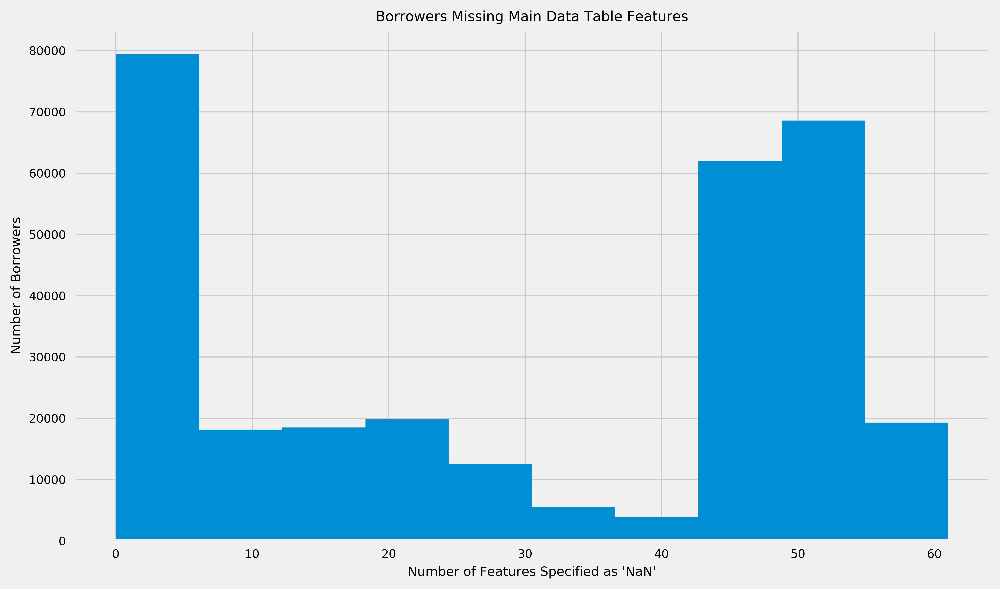

In [53]:
# Plot a histogram showing the number of borrowers that have a 
# certain amount of their feature data as 'NaN' entries.
plt.figure(figsize = (10,6))
plt.hist(borrowers_sorted_by_NaN_count)
plt.title('Borrowers Missing Main Data Table Features')
plt.xlabel('Number of Features Specified as \'NaN\'')
plt.ylabel('Number of Borrowers')
plt.savefig('borrowersnandata.png')
plt.show()

The above plot confirms that no borrowers are missing too many features such that they'd be considered outliers and would need to be removed from the trainingset.

At most, a borrower may be missing roughly only half of the main data table's 120 features. Just under 20,000 of the training dataset's 307,511 borrower records face this "worst-case" scenario. As it is, having 61 missing features falls well below the threshold at which I would decide to remove a borrower from the training dataset for having feature data that is too sparse. A borrower would have to be missing over 100 features, at least 5/6 of the featureset, for me to take the time to explore more deeply whether they may be an outlier. 

### Main Data Table Numerical and Categorical Feature Investigation: Unexpected Values

I explored samples from all features, as well as statistical descriptions of each numerical feature in the main data table (count, mean, standard deviation, minimum value, 25th percentile, 50th percentile, 75th percentile, and maximum value) to ensure that no features contained unexpected values that fall outside the range one would expect based on the feature's definition. 

Examples of unexpected values include entries that are impossibly small/large, or values that are negative when only positive values would be expected.

I came across the following five anomalies:

1. The following five numerical features indicate the number of days prior to the loan application's submission that a particular event took place:

  * `DAYS_BIRTH`
  * `DAYS_EMPLOYED`
  * `DAYS_REGISTRATION`
  * `DAYS_ID_PUBLISH`
  * `DAYS_LAST_PHONE_CHANGE`
  
 For example, `DAYS_LAST_PHONE_CHANGE` is defined by Home Credit as: *"How many days before application did client change phone?"* 
 
 Values for the above five features are negative, which is expected since each value represents a point in time prior to the time of the loan application's submission, which Home Credit defines as time 0, which is the maximum value for a few of these features.
 
 What's unexpected is that the `DAYS_EMPLOYED` feature (the number of days the applicant has had a job prior to the day they submitted their loan application) has a maximum value that is both a *positive* number as well as unbelievably large. The maximum value for `DAYS_EMPLOYED` is 365,243 days, or just over 1,000 years.
 
 No human being lives for 1,000 years, let alone sustains a job for that long, so this entry clearly indicates that some sort of mistake was made. What's not yet clear to me is whether `DAYS_EMPLOYED` contains only one, a handful, or possibly several such points. Clearly this particular data point and any similar to it are outliers that should be removed, especially if the `DAYS_EMPLOYED` feature turns out to be otherwise useful for predicting target values. Indeed, based on my intuition, `DAYS_EMPLOYED` is one of the first features that I would guess would be relevant in predicting whether a borrower would eventually make a late loan payment.
 
 Creating and inspecting a histogram of this feature's data should help me to guage whether or not there are any other outlier data points that would need to be removed.

* For the `CNT_CHILDREN` feature, although the most children any loan applicant had was 19, at least 75% of all applicants had either zero children or just one child. I decided that it makes most sense to treat  `CNT_CHILDREN` as a categorical feature, and re-engineer it to segment the borrower population into the following two categories: having no children, and having one or more children. Although I expect there will groups of borrowers of diminishing size that have 2,3,4,...,19 children, my hypothesis is that having no children versus having at least one child will be the information most useful to predict target values for the overall population of borrowers. Even if I were to spend time investigating the effects of having 2 vs. 3 vs. 4 vs. ... vs. 19 children, I know that my findings would apply to less than 25% of the overall population and any predictions informed by these effects likely wouldn't generalize well to unseen datapoints.
 
 I will transform the `CNT_CHILDREN` feature into a binary categorical feature called `HAS_CHILDREN`. If the value of `CNT_CHILDREN` is greater than 0, the value of `HAS_CHILDREN` will be 1. If the value of `CNT_CHILDREN` is 0, the value of `HAS_CHILDREN` will be 0.

* While most features reported as being normalized have a max value of 1.0 and a min value of 0.0. The following three features all have values within the range (0.0, 1.0), none of them have max values as 1.0, nor min values of 0.0. Even though Home Credit states that each of these three features have been normalized, because the max and min values of their range supposedly normalized values are different than what I've observed for all other features reported as normalized, I will need to pay special attention to the graphs of the distributions of these three features when I conduct my exploratory data visualization, in order to verify that these features' data is indeed distributed normally:
  * `EXT_SOURCE_1`
  * `EXT_SOURCE_2`
  * `EXT_SOURCE_3`
  
* The feature `REGION_POPULATION_RELATIVE` appears to be a unique case in that while it has also supposedly been normalized, its values merely fall into the range [0.000290, 0.072508]. All other features that Home Credit claims have been normalized more or less fall into the range [0.0,1.0]. It's therefore a given that I'll need to min-max scale this feature during data preprocessing.
  
* The following four features were defined by Home Credit as being "normalized":
  * `FONDKAPREMONT_MODE`
  * `HOUSETYPE_MODE`
  * `WALLSMATERIAL_MODE`
  * `EMERGENCYSTATE_MODE`
 
 Specifically, the definition contained in the [HomeCredit_columns_description.csv](https://www.kaggle.com/c/9120/download/HomeCredit_columns_description.csv) file provided by Home Credit stated that these features were:
 *"Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor"*

 However, upon further investigation I found that each of these four features was in fact categorical, and would need to be one-hot encoded. `WALLSMATERIAL_MODE`, for example, contains entries such as "Stone, brick", "panel", and "block" that indicate the material(s) of which the walls in the borrower's house are built.   

### Main Data Table Numerical and Categorical Feature Summary

I divided the main data table's features into groups based both on whether the feature is categorical or numerical, as well as how the feature would need to be preprocessed. ie. has the feature already been normalized, has it already been one-hot encoded, etc. Features that contain at least one 'NaN' value are highlighted in red. 

*All starred features I've experimented with omitting from training set.

Categorical features needing one-hot encoding:
1. NAME_CONTRACT_TYPE
* CODE_GENDER
* FLAG_OWN_CAR
* FLAG_OWN_REALTY
* NAME_INCOME_TYPE
* NAME_EDUCATION_TYPE
* NAME_FAMILY_STATUS
* NAME_HOUSING_TYPE
* REGION_RATING_CLIENT
* REGION_RATING_CLIENT_W_CITY
* WEEKDAY_APPR_PROCESS_START
* ORGANIZATION_TYPE
* <font color='red'>NAME_TYPE_SUITE (1,292 'NaN' entries)</font>
* <font color='red'>OCCUPATION_TYPE (96,391 'NaN' entries)</font>

Categorical features originally mis-identified by Home Credit as normalized (they also need to be one-hot encoded):
1. <font color='red'>EMERGENCYSTATE_MODE (145,755 'NaN' entries)</font>*
* <font color='red'>HOUSETYPE_MODE (154,297 'NaN' entries)</font>*
* <font color='red'>WALLSMATERIAL_MODE (156,341 'NaN' entries)</font>
* <font color='red'>FONDKAPREMONT_MODE (210,295 'NaN' entries)</font>


Categorical features needing re-engineering:

1. CNT_CHILDREN*: Will be transformed into a binary categorical feature called `HAS_CHILDREN`, with value of 1 if borrower has 0 children vs. a value of 1 if borrower has at least one child.

Binary Categorical features already one-hot encoded:
1. FLAG_MOBIL*
* FLAG_EMP_PHONE*
* FLAG_WORK_PHONE*
* FLAG_CONT_MOBILE*
* FLAG_PHONE*
* FLAG_EMAIL*
* REG_REGION_NOT_LIVE_REGION*
* REG_REGION_NOT_WORK_REGION*
* LIVE_REGION_NOT_WORK_REGION*
* REG_CITY_NOT_LIVE_CITY*
* REG_CITY_NOT_WORK_CITY*
* LIVE_CITY_NOT_WORK_CITY*
* FLAG_DOCUMENT_2*
* FLAG_DOCUMENT_3*
* FLAG_DOCUMENT_4*
* FLAG_DOCUMENT_5*
* FLAG_DOCUMENT_6*
* FLAG_DOCUMENT_7*
* FLAG_DOCUMENT_8*
* FLAG_DOCUMENT_9*
* FLAG_DOCUMENT_10*
* FLAG_DOCUMENT_11*
* FLAG_DOCUMENT_12*
* FLAG_DOCUMENT_13*
* FLAG_DOCUMENT_14*
* FLAG_DOCUMENT_15*
* FLAG_DOCUMENT_16*
* FLAG_DOCUMENT_17*
* FLAG_DOCUMENT_18*
* FLAG_DOCUMENT_19*
* FLAG_DOCUMENT_20*
* FLAG_DOCUMENT_21*


Numerical features not identified as normalized, that have roughly normal distributions:
1. DAYS_BIRTH
* DAYS_ID_PUBLISH*
* HOUR_APPR_PROCESS_START*

Numerical features not identified as normalized, that have skewed distributions, and only positive values:
1. AMT_INCOME_TOTAL
* AMT_CREDIT
* <font color='red'>CNT_FAM_MEMBERS (2 'NaN' entries)</font>
* <font color='red'>AMT_ANNUITY (12 'NaN' entries)</font>
* <font color='red'>AMT_GOODS_PRICE (278 'NaN' entries)</font>
* <font color='red'>OBS_30_CNT_SOCIAL_CIRCLE (1,021 'NaN' entries)</font>
* <font color='red'>DEF_30_CNT_SOCIAL_CIRCLE (1,021 'NaN' entries)</font>
* <font color='red'>OBS_60_CNT_SOCIAL_CIRCLE (1,021 'NaN' entries)</font>
* <font color='red'>DEF_60_CNT_SOCIAL_CIRCLE (1,021 'NaN' entries)</font>
* <font color='red'>AMT_REQ_CREDIT_BUREAU_HOUR (41,519 'NaN' entries)</font>
* <font color='red'>AMT_REQ_CREDIT_BUREAU_DAY (41,519 'NaN' entries)</font>
* <font color='red'>AMT_REQ_CREDIT_BUREAU_WEEK (41,519 'NaN' entries)</font>
* <font color='red'>AMT_REQ_CREDIT_BUREAU_MON (41,519 'NaN' entries)</font>
* <font color='red'>AMT_REQ_CREDIT_BUREAU_QRT (41,519 'NaN' entries)</font>
* <font color='red'>AMT_REQ_CREDIT_BUREAU_YEAR (41,519 'NaN' entries)</font>
* <font color='red'>OWN_CAR_AGE (202,929 'NaN' entries)</font>

Numerical features not identified as normalized, that have skewed distributions and negative values:
1. DAYS_EMPLOYED: Will be transformed into a binary categorical feature called `HAS_JOB`, with value of 1 if borrower has a value of 0 or less for `DAYS_EMPLOYED`. `HAS_JOB` will have a value of 0 if the borrower is one of the 55,374 folks who has a value of 365243 for `DAYS_EMPLOYED`.
* DAYS_REGISTRATION*
* <font color='red'>DAYS_LAST_PHONE_CHANGE (1 'NaN' entry)</font>*

Numerical features identified as normalized, which are scaled to range [0,1]:
1. <font color='red'>EXT_SOURCE_2 (660 'NaN' entries)</font>
* <font color='red'>EXT_SOURCE_3 (60,965 'NaN' entries)</font>
* <font color='red'>TOTALAREA_MODE (148,431 'NaN' entries)</font>
* <font color='red'>YEARS_BEGINEXPLUATATION_AVG (150,007 'NaN' entries)</font>
* <font color='red'>YEARS_BEGINEXPLUATATION_MODE (150,007 'NaN' entries)</font>
* <font color='red'>YEARS_BEGINEXPLUATATION_MEDI (150,007 'NaN' entries)</font>
* <font color='red'>FLOORSMAX_AVG (153,020 'NaN' entries)</font>
* <font color='red'>FLOORSMAX_MODE (153,020 'NaN' entries)</font>
* <font color='red'>FLOORSMAX_MEDI (153,020 'NaN' entries)</font>
* <font color='red'>LIVINGAREA_AVG (154,350 'NaN' entries)</font>
* <font color='red'>LIVINGAREA_MODE (154,350 'NaN' entries)</font>
* <font color='red'>LIVINGAREA_MEDI (154,350 'NaN' entries)</font>
* <font color='red'>ENTRANCES_AVG (154,828 'NaN' entries)</font>
* <font color='red'>ENTRANCES_MODE (154,828 'NaN' entries)</font>
* <font color='red'>ENTRANCES_MEDI (154,828 'NaN' entries)</font>
* <font color='red'>APARTMENTS_AVG (156,061 'NaN' entries)</font>
* <font color='red'>APARTMENTS_MODE (156,061 'NaN' entries)</font>
* <font color='red'>APARTMENTS_MEDI (156,061 'NaN' entries)</font>
* <font color='red'>ELEVATORS_AVG (163,891 'NaN' entries)</font>
* <font color='red'>ELEVATORS_MODE (163,891 'NaN' entries)</font>
* <font color='red'>ELEVATORS_MEDI (163,891 'NaN' entries)</font>
* <font color='red'>NONLIVINGAREA_AVG (169,682 'NaN' entries)</font>
* <font color='red'>NONLIVINGAREA_MODE (169,682 'NaN' entries)</font>
* <font color='red'>NONLIVINGAREA_MEDI (169,682 'NaN' entries)</font>
* <font color='red'>EXT_SOURCE_1 (173,378 'NaN' entries)</font>
* <font color='red'>BASEMENTAREA_AVG (179,943 'NaN' entries)</font>
* <font color='red'>BASEMENTAREA_MODE (179,943 'NaN' entries)</font>
* <font color='red'>BASEMENTAREA_MEDI (179,943 'NaN' entries)</font>
* <font color='red'>LANDAREA_AVG (182,590 'NaN' entries)</font>
* <font color='red'>LANDAREA_MODE (182,590 'NaN' entries)</font>
* <font color='red'>LANDAREA_MEDI (182,590 'NaN' entries)</font>
* <font color='red'>YEARS_BUILD_AVG (204,488 'NaN' entries)</font>
* <font color='red'>YEARS_BUILD_MODE (204,488 'NaN' entries)</font>
* <font color='red'>YEARS_BUILD_MEDI (204,488 'NaN' entries)</font>
* <font color='red'>FLOORSMIN_AVG (208,642 'NaN' entries)</font>
* <font color='red'>FLOORSMIN_MODE (208,642 'NaN' entries)</font>
* <font color='red'>FLOORSMIN_MEDI (208,642 'NaN' entries)</font>
* <font color='red'>LIVINGAPARTMENTS_AVG (210,199 'NaN' entries)</font>
* <font color='red'>LIVINGAPARTMENTS_MODE (210,199 'NaN' entries)</font>
* <font color='red'>LIVINGAPARTMENTS_MEDI (210,199 'NaN' entries)</font>
* <font color='red'>NONLIVINGAPARTMENTS_AVG (213,514 'NaN' entries)</font>
* <font color='red'>NONLIVINGAPARTMENTS_MODE (213,514 'NaN' entries)</font>
* <font color='red'>NONLIVINGAPARTMENTS_MEDI (213,514 'NaN' entries)</font>
* <font color='red'>COMMONAREA_AVG (214,865 'NaN' entries)</font>
* <font color='red'>COMMONAREA_MODE (214,865 'NaN' entries)</font>
* <font color='red'>COMMONAREA_MEDI (214,865 'NaN' entries)</font>

Numerical features identified as normalized, which are *not* scaled to range [0,1]:
1. REGION_POPULATION_RELATIVE*
    

Summing the above lists gives 14+4+1+32+3+16+3+46+1 = 120 features, which are all of the features in the main data table. 

**Main Data Table Featureset Definitions**

1. **SK_ID_CURR**: ID of loan in our sample	
* **TARGET**: Target variable (1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample, 0 - all other cases)	
* **NAME_CONTRACT_TYPE**: Identification if loan is cash or revolving	
* **CODE_GENDER**: Gender of the client	
* **FLAG_OWN_CAR**: Flag if the client owns a car	
* **FLAG_OWN_REALTY**: Flag if client owns a house or flat	
* **CNT_CHILDREN**: Number of children the client has	
* **AMT_INCOME_TOTAL**: Income of the client	
* **AMT_CREDIT**: Credit amount of the loan	
* **AMT_ANNUITY**: Loan annuity	
* **AMT_GOODS_PRICE**: For consumer loans it is the price of the goods for which the loan is given	
* **NAME_TYPE_SUITE**: Who was accompanying client when he was applying for the loan	
* **NAME_INCOME_TYPE**: Clients income type (businessman, working, maternity leave,Ö)	
* **NAME_EDUCATION_TYPE**: Level of highest education the client achieved
* **NAME_FAMILY_STATUS**: Family status of the client	
* **NAME_HOUSING_TYPE**: What is the housing situation of the client (renting, living with parents, ...)	
* **REGION_POPULATION_RELATIVE**: Normalized population of region where client lives (higher number means the client lives in more populated region) -- normalized
* **DAYS_BIRTH**: Client's age in days at the time of application -- time only relative to the application
* **DAYS_EMPLOYED**: How many days before the application the person started current employment -- time only relative to the application
* **DAYS_REGISTRATION**: How many days before the application did client change his registration -- time only relative to the application
* **DAYS_ID_PUBLISH**: How many days before the application did client change the identity document with which he applied for the loan -- time only relative to the application
* **OWN_CAR_AGE**: Age of client's car	
* **FLAG_MOBIL**: Did client provide mobile phone (1=YES, 0=NO)	
* **FLAG_EMP_PHONE**: Did client provide work phone (1=YES, 0=NO)	
* **FLAG_WORK_PHONE**: Did client provide home phone (1=YES, 0=NO)	
* **FLAG_CONT_MOBILE**: Was mobile phone reachable (1=YES, 0=NO)	
* **FLAG_PHONE**: Did client provide home phone (1=YES, 0=NO)	
* **FLAG_EMAIL**: Did client provide email (1=YES, 0=NO)	
* **OCCUPATION_TYPE**: What kind of occupation does the client have	
* **CNT_FAM_MEMBERS**: How many family members does client have	
* **REGION_RATING_CLIENT**: Our rating of the region where client lives (1,2,3)	
* **REGION_RATING_CLIENT_W_CITY**: Our rating of the region where client lives with taking city into account (1,2,3)	
* **WEEKDAY_APPR_PROCESS_START**: On which day of the week did the client apply for the loan	
* **HOUR_APPR_PROCESS_START**: Approximately at what hour did the client apply for the loan	rounded
* **REG_REGION_NOT_LIVE_REGION**: Flag if client's permanent address does not match contact address (1=different, 0=same, at region level)	
* **REG_REGION_NOT_WORK_REGION**: Flag if client's permanent address does not match work address (1=different, 0=same, at region level)	
* **LIVE_REGION_NOT_WORK_REGION**: Flag if client's contact address does not match work address (1=different, 0=same, at region level)	
* **REG_CITY_NOT_LIVE_CITY**: Flag if client's permanent address does not match contact address (1=different, 0=same, at city level)	
* **REG_CITY_NOT_WORK_CITY**: Flag if client's permanent address does not match work address (1=different, 0=same, at city level)	
* **LIVE_CITY_NOT_WORK_CITY**: Flag if client's contact address does not match work address (1=different, 0=same, at city level)	
* **ORGANIZATION_TYPE**: Type of organization where client works	
* **EXT_SOURCE_1**: Normalized score from external data source -- normalized
* **EXT_SOURCE_2**: Normalized score from external data source -- normalized
* **EXT_SOURCE_3**: Normalized score from external data source -- normalized
* **APARTMENTS_AVG**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **BASEMENTAREA_AVG**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **YEARS_BEGINEXPLUATATION_AVG**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **YEARS_BUILD_AVG**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **COMMONAREA_AVG**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **ELEVATORS_AVG**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **ENTRANCES_AVG**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **FLOORSMAX_AVG**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **FLOORSMIN_AVG**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **LANDAREA_AVG**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **LIVINGAPARTMENTS_AVG**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **LIVINGAREA_AVG**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **NONLIVINGAPARTMENTS_AVG**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **NONLIVINGAREA_AVG**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **APARTMENTS_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **BASEMENTAREA_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **YEARS_BEGINEXPLUATATION_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **YEARS_BUILD_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **COMMONAREA_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **ELEVATORS_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **ENTRANCES_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **FLOORSMAX_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **FLOORSMIN_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **LANDAREA_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **LIVINGAPARTMENTS_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **LIVINGAREA_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **NONLIVINGAPARTMENTS_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **NONLIVINGAREA_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **APARTMENTS_MEDI**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **BASEMENTAREA_MEDI**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **YEARS_BEGINEXPLUATATION_MEDI**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **YEARS_BUILD_MEDI**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **COMMONAREA_MEDI**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **ELEVATORS_MEDI**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **ENTRANCES_MEDI**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **FLOORSMAX_MEDI**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **FLOORSMIN_MEDI**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **LANDAREA_MEDI**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **LIVINGAPARTMENTS_MEDI**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **LIVINGAREA_MEDI**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **NONLIVINGAPARTMENTS_MEDI**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **NONLIVINGAREA_MEDI**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **FONDKAPREMONT_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **HOUSETYPE_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **TOTALAREA_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **WALLSMATERIAL_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **EMERGENCYSTATE_MODE**: Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor -- normalized
* **OBS_30_CNT_SOCIAL_CIRCLE**: How many observation of client's social surroundings with observable 30 DPD (days past due) default	
* **DEF_30_CNT_SOCIAL_CIRCLE**: How many observation of client's social surroundings defaulted on 30 DPD (days past due) 	
* **OBS_60_CNT_SOCIAL_CIRCLE**: How many observation of client's social surroundings with observable 60 DPD (days past due) default	
* **DEF_60_CNT_SOCIAL_CIRCLE**: How many observation of client's social surroundings defaulted on 60 (days past due) DPD	
* **DAYS_LAST_PHONE_CHANGE**: How many days before application did client change phone	
* **FLAG_DOCUMENT_2**: Did client provide document 2	
* **FLAG_DOCUMENT_3**: Did client provide document 3	
* **FLAG_DOCUMENT_4**: Did client provide document 4	
* **FLAG_DOCUMENT_5**: Did client provide document 5	
* **FLAG_DOCUMENT_6**: Did client provide document 6	
* **FLAG_DOCUMENT_7**: Did client provide document 7	
* **FLAG_DOCUMENT_8**: Did client provide document 8	
* **FLAG_DOCUMENT_9**: Did client provide document 9	
* **FLAG_DOCUMENT_10**: Did client provide document 10	
* **FLAG_DOCUMENT_11**: Did client provide document 11	
* **FLAG_DOCUMENT_12**: Did client provide document 12	
* **FLAG_DOCUMENT_13**: Did client provide document 13	
* **FLAG_DOCUMENT_14**: Did client provide document 14	
* **FLAG_DOCUMENT_15**: Did client provide document 15	
* **FLAG_DOCUMENT_16**: Did client provide document 16	
* **FLAG_DOCUMENT_17**: Did client provide document 17	
* **FLAG_DOCUMENT_18**: Did client provide document 18	
* **FLAG_DOCUMENT_19**: Did client provide document 19	
* **FLAG_DOCUMENT_20**: Did client provide document 20	
* **FLAG_DOCUMENT_21**: Did client provide document 21	
* **AMT_REQ_CREDIT_BUREAU_HOUR**: Number of enquiries to Credit Bureau about the client one hour before application
* **AMT_REQ_CREDIT_BUREAU_DAY**: Number of enquiries to Credit Bureau about the client one day before application (excluding one hour before application)	
* **AMT_REQ_CREDIT_BUREAU_WEEK**: Number of enquiries to Credit Bureau about the client one week before application (excluding one day before application)	
* **AMT_REQ_CREDIT_BUREAU_MON**: Number of enquiries to Credit Bureau about the client one month before application (excluding one week before application)	
* **AMT_REQ_CREDIT_BUREAU_QRT**: Number of enquiries to Credit Bureau about the client 3 month before application (excluding one month before application)	
* **AMT_REQ_CREDIT_BUREAU_YEAR**: Number of enquiries to Credit Bureau about the client one day year (excluding last 3 months before application)

### Compositions of Categorical Features

In [6]:
display(application_train_data['NAME_CONTRACT_TYPE'].value_counts())

Cash loans         278232
Revolving loans     29279
Name: NAME_CONTRACT_TYPE, Length: 2, dtype: int64

In [7]:
display(application_train_data['CODE_GENDER'].value_counts())

F      202448
M      105059
XNA         4
Name: CODE_GENDER, Length: 3, dtype: int64

In [8]:
display(application_train_data['FLAG_OWN_CAR'].value_counts())

N    202924
Y    104587
Name: FLAG_OWN_CAR, Length: 2, dtype: int64

In [9]:
display(application_train_data['FLAG_OWN_REALTY'].value_counts())

Y    213312
N     94199
Name: FLAG_OWN_REALTY, Length: 2, dtype: int64

In [10]:
display(application_train_data['NAME_INCOME_TYPE'].value_counts())

Working                 158774
Commercial associate     71617
Pensioner                55362
State servant            21703
Unemployed                  22
Student                     18
Businessman                 10
Maternity leave              5
Name: NAME_INCOME_TYPE, Length: 8, dtype: int64

In [11]:
display(application_train_data['NAME_EDUCATION_TYPE'].value_counts())

Secondary / secondary special    218391
Higher education                  74863
Incomplete higher                 10277
Lower secondary                    3816
Academic degree                     164
Name: NAME_EDUCATION_TYPE, Length: 5, dtype: int64

In [12]:
display(application_train_data['NAME_FAMILY_STATUS'].value_counts())

Married                 196432
Single / not married     45444
Civil marriage           29775
Separated                19770
Widow                    16088
Unknown                      2
Name: NAME_FAMILY_STATUS, Length: 6, dtype: int64

In [13]:
display(application_train_data['NAME_HOUSING_TYPE'].value_counts())

House / apartment      272868
With parents            14840
Municipal apartment     11183
Rented apartment         4881
Office apartment         2617
Co-op apartment          1122
Name: NAME_HOUSING_TYPE, Length: 6, dtype: int64

In [14]:
display(application_train_data['REGION_RATING_CLIENT'].value_counts())

2    226984
3     48330
1     32197
Name: REGION_RATING_CLIENT, Length: 3, dtype: int64

In [15]:
display(application_train_data['REGION_RATING_CLIENT_W_CITY'].value_counts())

2    229484
3     43860
1     34167
Name: REGION_RATING_CLIENT_W_CITY, Length: 3, dtype: int64

In [16]:
display(application_train_data['WEEKDAY_APPR_PROCESS_START'].value_counts())

TUESDAY      53901
WEDNESDAY    51934
MONDAY       50714
THURSDAY     50591
FRIDAY       50338
SATURDAY     33852
SUNDAY       16181
Name: WEEKDAY_APPR_PROCESS_START, Length: 7, dtype: int64

In [17]:
display(application_train_data['ORGANIZATION_TYPE'].value_counts())

Business Entity Type 3    67992
XNA                       55374
Self-employed             38412
Other                     16683
Medicine                  11193
Business Entity Type 2    10553
Government                10404
School                     8893
Trade: type 7              7831
Kindergarten               6880
Construction               6721
Business Entity Type 1     5984
Transport: type 4          5398
Trade: type 3              3492
Industry: type 9           3368
Industry: type 3           3278
Security                   3247
Housing                    2958
Industry: type 11          2704
Military                   2634
Bank                       2507
Agriculture                2454
Police                     2341
Transport: type 2          2204
Postal                     2157
Security Ministries        1974
Trade: type 2              1900
Restaurant                 1811
Services                   1575
University                 1327
Industry: type 7           1307
Transpor

In [18]:
display(application_train_data['NAME_TYPE_SUITE'].value_counts())

Unaccompanied      248526
Family              40149
Spouse, partner     11370
Children             3267
Other_B              1770
Other_A               866
Group of people       271
Name: NAME_TYPE_SUITE, Length: 7, dtype: int64

In [19]:
display(application_train_data['OCCUPATION_TYPE'].value_counts())

Laborers                 55186
Sales staff              32102
Core staff               27570
Managers                 21371
Drivers                  18603
High skill tech staff    11380
Accountants               9813
Medicine staff            8537
Security staff            6721
Cooking staff             5946
Cleaning staff            4653
Private service staff     2652
Low-skill Laborers        2093
Waiters/barmen staff      1348
Secretaries               1305
Realty agents              751
HR staff                   563
IT staff                   526
Name: OCCUPATION_TYPE, Length: 18, dtype: int64

In [20]:
display(application_train_data['WALLSMATERIAL_MODE'].value_counts())

Panel           66040
Stone, brick    64815
Block            9253
Wooden           5362
Mixed            2296
Monolithic       1779
Others           1625
Name: WALLSMATERIAL_MODE, Length: 7, dtype: int64

In [21]:
display(application_train_data['FONDKAPREMONT_MODE'].value_counts())

reg oper account         73830
reg oper spec account    12080
not specified             5687
org spec account          5619
Name: FONDKAPREMONT_MODE, Length: 4, dtype: int64

In [22]:
display(application_train_data['EMERGENCYSTATE_MODE'].value_counts())

No     159428
Yes      2328
Name: EMERGENCYSTATE_MODE, Length: 2, dtype: int64

In [23]:
display(application_train_data['HOUSETYPE_MODE'].value_counts())

block of flats      150503
specific housing      1499
terraced house        1212
Name: HOUSETYPE_MODE, Length: 3, dtype: int64

In [24]:
display(application_train_data['CNT_CHILDREN'].value_counts())

0     215371
1      61119
2      26749
3       3717
4        429
5         84
6         21
7          7
14         3
19         2
12         2
10         2
9          2
8          2
11         1
Name: CNT_CHILDREN, Length: 15, dtype: int64

In [25]:
display(application_train_data['CNT_FAM_MEMBERS'].value_counts())

2.0     158357
1.0      67847
3.0      52601
4.0      24697
5.0       3478
6.0        408
7.0         81
8.0         20
9.0          6
10.0         3
14.0         2
16.0         2
12.0         2
20.0         2
11.0         1
13.0         1
15.0         1
Name: CNT_FAM_MEMBERS, Length: 17, dtype: int64

### Compositions of EXT_SOURCE features (amount of NaN in each)

In [49]:
display(application_train_data['EXT_SOURCE_1'].isnull().sum())

173378

In [50]:
display(application_train_data['EXT_SOURCE_2'].isnull().sum())

660

In [51]:
display(application_train_data['EXT_SOURCE_3'].isnull().sum())

60965

### Plot Distributions of Numerical Main Data Table Features Identified as Normalized

Home Credit had identified the following 47 numerical features as being normalized. I plotted histograms of each of these features in order to confirm that this is indeed that case, as well as to identify any outliers that might need to be removed. 

```
'REGION_POPULATION_RELATIVE', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'APARTMENTS_AVG', 'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG', 'COMMONAREA_AVG', 'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG', 'APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE', 'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE', 'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAREA_MODE', 'APARTMENTS_MEDI', 'BASEMENTAREA_MEDI', 'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI', 'ELEVATORS_MEDI', 'ENTRANCES_MEDI', 'FLOORSMAX_MEDI', 'FLOORSMIN_MEDI', 'LANDAREA_MEDI', 'LIVINGAPARTMENTS_MEDI', 'LIVINGAREA_MEDI', 'NONLIVINGAPARTMENTS_MEDI', 'NONLIVINGAREA_MEDI', 'TOTALAREA_MODE'
```

The plotted histograms ignored all 'NaN' entries in each of the above features. Plots for all 47 features can be viewed in the Appendix.

In [34]:
# List of normalized features
normalized_numerical_features = ['REGION_POPULATION_RELATIVE', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'APARTMENTS_AVG', 'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG', 'COMMONAREA_AVG', 'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG', 'APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE', 'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE', 'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAREA_MODE', 'APARTMENTS_MEDI', 'BASEMENTAREA_MEDI', 'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI', 'ELEVATORS_MEDI', 'ENTRANCES_MEDI', 'FLOORSMAX_MEDI', 'FLOORSMIN_MEDI', 'LANDAREA_MEDI', 'LIVINGAPARTMENTS_MEDI', 'LIVINGAREA_MEDI', 'NONLIVINGAPARTMENTS_MEDI', 'NONLIVINGAREA_MEDI', 'TOTALAREA_MODE']

# Plot histogram of each normalized feature, omitting any rows (borrowers) that have a value 
# of 'NaN' for the particular feature
vs.plot_feature_distributions(application_train_data[normalized_numerical_features], title='Distributions of Main Data Table\'s Normalized Features', figsize=(14,60), num_cols=3)

I paid special attention to the distributions of the four features I had found anomalous while initially exploring the dataset, `REGION_POPULATION_RELATIVE`, `EXT_SOURCE_1`, `EXT_SOURCE_2`, and `EXT_SOURCE_3`.

It turned out that `EXT_SOURCE_1`, `EXT_SOURCE_2`, and `EXT_SOURCE_3` were the three features I should have been least concerned about -- the shapes of these features' distributions more closely resembled that of the normal bell curve than the shapes of all the other normalized numerical features. And upon closer review, perhaps this shouldn't be so surprising. According to Home Credit's definitions, these three features represent normalized scores that come from an "external data source," and I can only surmise that whatever methodology the external source used to devise and assign these scores may be what causes their values to be more normally distributed across the dataset.

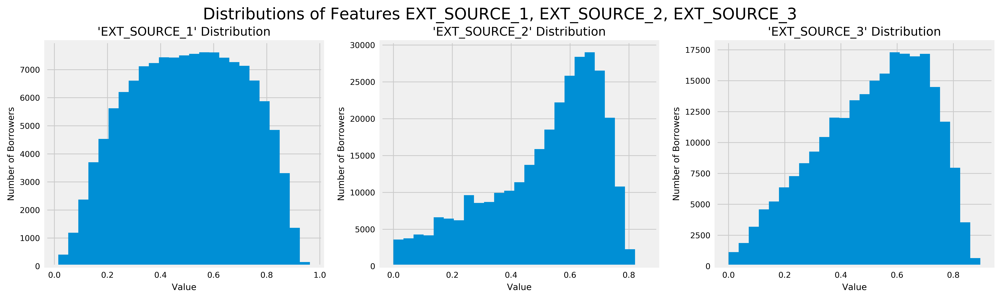

In [4]:
# Plot histogram of ['EXT_SOURCE_1','EXT_SOURCE_2','EXT_SOURCE_3'], omitting any rows (borrowers) that have a value 
# of 'NaN' for the particular feature
vs.plot_feature_distributions(application_train_data[['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3']], title='Distributions of Features EXT_SOURCE_1, EXT_SOURCE_2, EXT_SOURCE_3', figsize=(14,4), num_cols=3)

As I had discovered while exploring the dataset, the feature `REGION_POPULATION_RELATIVE` does indeed have all its values within an approximate range of [0.00,0.07]. There is nothing in the feature's definition that suggests why, out of all the other normalized features, that this would be the only feature not scaled to the range [0.0,1.0]. Thankfully, this feature also exhibits minimal positive/negative skewness. The only adjustment necessary would be to min-max scale this feature to the range [0.0,1.0] when preprocessing the data. 

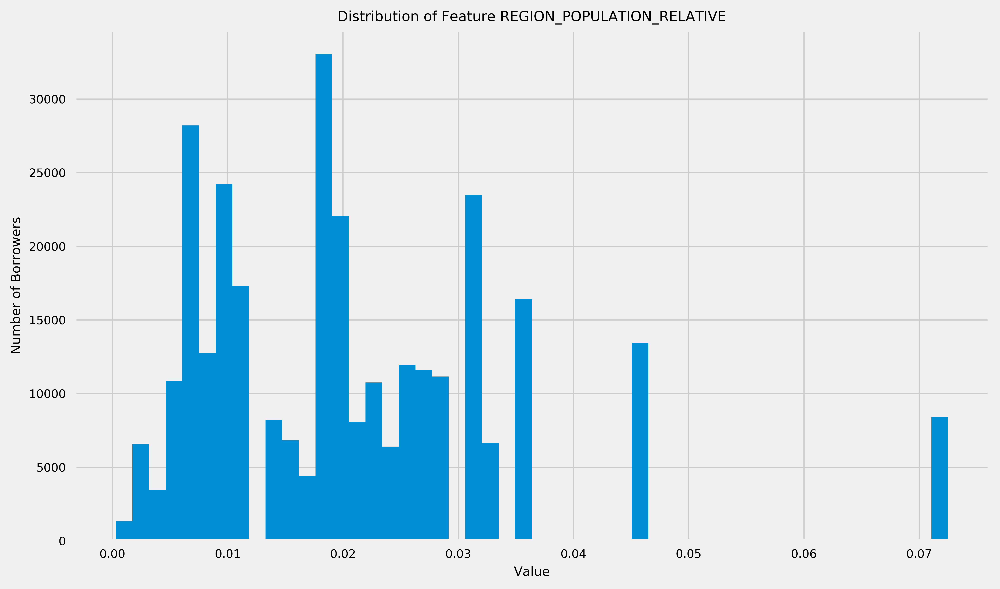

In [52]:
# Plot histogram of ['REGION_POPULATION_RELATIVE'], omitting any rows (borrowers) that have a value 
# of 'NaN' for the particular feature
region_population_relative_data = application_train_data['REGION_POPULATION_RELATIVE']
filtered_region_population_relative_data = region_population_relative_data[~np.isnan(region_population_relative_data)]
plt.figure(figsize = (10,6))
plt.hist(filtered_region_population_relative_data, bins=50)
plt.title('Distribution of Feature REGION_POPULATION_RELATIVE')
plt.xlabel('Value')
plt.ylabel('Number of Borrowers')
plt.savefig('distribREGIONPOPULATIONRELATIVE.png')
plt.show()

Other normalized features, particularly those concerning general characteristics of a borrower's residence, such as `YEARS_BUILD_AVG`, `FLOORSMIN_MODE`, and `FLOORSMAX_AVG` also had the appearance of a normal distribution without much positive or negative skewness. This intuitively makes sense as these general features about number of floors and the year the residence was built will pertain to all individuals' residences, regardless of the dwelling type.

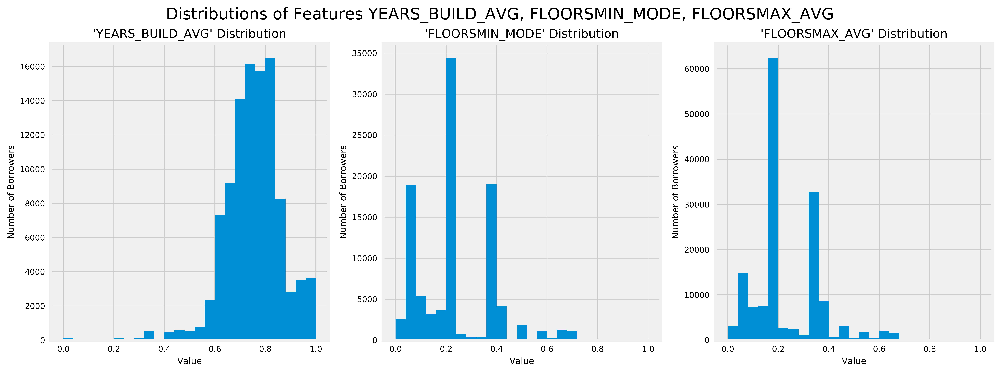

In [28]:
# Plot histogram of ['YEARS_BUILD_AVG', 'FLOORSMIN_MODE, 'FLOORSMAX_AVG'], omitting any rows (borrowers) that have a value 
# of 'NaN' for the particular feature
vs.plot_feature_distributions(application_train_data[['YEARS_BUILD_AVG', 'FLOORSMIN_MODE', 'FLOORSMAX_AVG']], title='Distributions of Features YEARS_BUILD_AVG, FLOORSMIN_MODE, FLOORSMAX_AVG', figsize=(14,5), num_cols=3)


On the other hand, the rest of the normalized features, such as `ELEVATORS_MEDI`, `COMMONAREA_MEDI`, `NONLIVINGAPARTMENTS_MEDI`, describe more niche characteristics of a residence building that may not apply to many of the borrowers. For example, individuals who live in a house wouldn't be expected to have any elevators, a public common area, or non-living apartments in their residence. And as such, these features tend to be noticeably positively skewed.

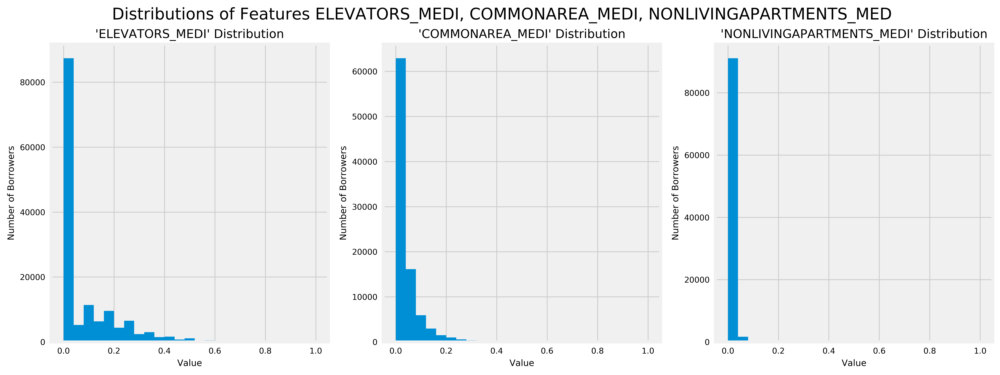

In [33]:
# Plot histogram of ['EXT_SOURCE_1','EXT_SOURCE_2','EXT_SOURCE_3'], omitting any rows (borrowers) that have a value 
# of 'NaN' for the particular feature
vs.plot_feature_distributions(application_train_data[['ELEVATORS_MEDI', 'COMMONAREA_MEDI', 'NONLIVINGAPARTMENTS_MEDI']], title='Distributions of Features ELEVATORS_MEDI, COMMONAREA_MEDI, NONLIVINGAPARTMENTS_MED', figsize=(14,5), num_cols=3)


### Compositions of Non-Normalized Main Data Table Numerical Features

In [26]:
display(application_train_data['CNT_FAM_MEMBERS'].value_counts())

2.0     158357
1.0      67847
3.0      52601
4.0      24697
5.0       3478
6.0        408
7.0         81
8.0         20
9.0          6
10.0         3
14.0         2
16.0         2
12.0         2
20.0         2
11.0         1
13.0         1
15.0         1
Name: CNT_FAM_MEMBERS, Length: 17, dtype: int64

In [27]:
display(application_train_data['AMT_INCOME_TOTAL'].value_counts())

135000.000     35750
112500.000     31019
157500.000     26556
180000.000     24719
90000.000      22483
225000.000     20698
202500.000     16341
67500.000      11147
270000.000     10827
81000.000       6001
315000.000      5862
247500.000      5344
126000.000      4668
360000.000      4115
121500.000      3848
99000.000       3633
292500.000      3418
103500.000      3330
76500.000       3146
144000.000      3123
171000.000      2647
450000.000      2435
117000.000      2390
54000.000       2319
72000.000       2187
166500.000      2053
45000.000       2043
108000.000      1946
337500.000      1790
94500.000       1747
162000.000      1702
189000.000      1691
405000.000      1660
85500.000       1514
148500.000      1486
216000.000      1406
130500.000      1256
58500.000       1182
63000.000       1145
193500.000      1061
153000.000      1012
211500.000       985
382500.000       966
139500.000       834
175500.000       800
540000.000       758
49500.000        738
234000.000   

In [28]:
display(application_train_data['AMT_CREDIT'].value_counts())

450000.0     9709
675000.0     8877
225000.0     8162
180000.0     7342
270000.0     7241
900000.0     6246
254700.0     4500
545040.0     4437
808650.0     4152
135000.0     3660
755190.0     3524
1125000.0    3493
521280.0     3175
284400.0     3096
1078200.0    2856
454500.0     2649
1288350.0    2613
269550.0     2463
202500.0     2339
781920.0     2328
1350000.0    2321
239850.0     2084
315000.0     2072
247500.0     2057
640080.0     2041
1006920.0    1883
540000.0     1821
360000.0     1743
508495.5     1717
592560.0     1688
497520.0     1665
405000.0     1661
835380.0     1600
337500.0     1588
679500.0     1555
942300.0     1431
314100.0     1394
152820.0     1366
1546020.0    1279
495000.0     1268
157500.0     1203
585000.0     1200
728460.0     1065
526491.0     1012
544491.0     1009
343800.0      939
1223010.0     930
312768.0      929
247275.0      920
1800000.0     900
814041.0      897
630000.0      895
490495.5      842
101880.0      841
263686.5      827
760225.5  

In [29]:
display(application_train_data['AMT_ANNUITY'].value_counts())

9000.0      6385
13500.0     5514
6750.0      2279
10125.0     2035
37800.0     1602
11250.0     1459
26217.0     1453
20250.0     1345
12375.0     1339
31653.0     1269
26640.0     1236
22500.0     1234
16875.0     1213
36459.0     1191
33025.5      938
26446.5      916
22018.5      904
23773.5      875
25537.5      836
26316.0      829
31261.5      822
21906.0      800
7875.0       741
40320.0      703
21888.0      688
32602.5      687
15750.0      684
27000.0      681
19867.5      653
33750.0      652
29970.0      643
21775.5      643
30528.0      626
45000.0      570
32895.0      564
14350.5      564
14751.0      551
23494.5      540
42790.5      527
26086.5      507
29250.0      506
23931.0      501
31630.5      499
31522.5      495
24939.0      491
16456.5      490
19125.0      471
21109.5      466
13963.5      462
30078.0      450
28408.5      449
45333.0      441
46084.5      436
67500.0      431
16011.0      419
24543.0      418
35937.0      418
25321.5      417
24246.0      4

In [30]:
display(application_train_data['AMT_GOODS_PRICE'].value_counts())

450000.0     26022
225000.0     25282
675000.0     24962
900000.0     15416
270000.0     11428
180000.0     10123
454500.0      9157
1125000.0     9050
135000.0      8206
315000.0      5225
1350000.0     5037
679500.0      4824
238500.0      4696
360000.0      4553
247500.0      4318
463500.0      3873
540000.0      3763
495000.0      3463
202500.0      3222
90000.0       3169
405000.0      2954
472500.0      2828
157500.0      2704
585000.0      2647
337500.0      2501
229500.0      2438
112500.0      2170
630000.0      2164
1800000.0     2146
720000.0      1922
1575000.0     1875
688500.0      1824
292500.0      1708
148500.0      1674
477000.0      1611
810000.0      1568
67500.0       1505
697500.0      1408
382500.0      1396
765000.0      1396
904500.0      1375
283500.0      1372
252000.0      1368
234000.0      1279
45000.0       1169
945000.0      1161
855000.0      1113
1129500.0     1109
913500.0      1065
328500.0      1059
459000.0      1023
193500.0      1007
103500.0    

In [31]:
display(application_train_data['DAYS_BIRTH'].value_counts())

-13749    43
-13481    42
-18248    41
-10020    41
-15771    40
-10292    40
-14395    39
-14267    39
-13263    39
-11664    39
-13584    38
-15565    38
-13788    38
-13480    38
-15042    38
-13634    38
-13891    38
-14791    38
-13217    37
-15450    37
-10136    37
-20074    37
-15048    37
-16690    37
-10107    37
-15563    37
-14790    37
-14767    37
-10192    37
-14890    37
-16257    37
-12806    37
-11108    37
-14276    37
-13706    36
-13904    36
-15322    36
-14926    36
-13708    36
-13643    36
-11524    36
-13271    36
-10519    36
-14137    36
-14776    36
-14386    36
-10213    35
-16490    35
-10123    35
-11588    35
-9981     35
-11266    35
-15044    35
-10088    35
-14120    35
-15073    35
-14825    35
-11097    35
-12776    35
-15155    35
-13254    35
-13273    35
-13922    35
-14099    35
-10223    35
-10978    35
-12682    35
-15164    35
-16185    35
-11135    35
-14131    35
-15009    35
-14384    35
-12433    35
-14350    35
-16830    35
-13687    35

In [32]:
display(application_train_data['DAYS_EMPLOYED'].value_counts())

 365243    55374
-200         156
-224         152
-199         151
-230         151
-212         150
-229         143
-384         143
-231         140
-215         138
-207         138
-188         137
-216         137
-116         136
-196         136
-222         135
-193         134
-195         133
-214         132
-213         131
-254         131
-381         130
-201         130
-233         128
-185         128
-237         127
-194         127
-184         126
-234         126
-209         125
-348         125
-241         124
-745         123
-137         123
-139         122
-382         122
-238         122
-198         122
-240         120
-205         120
-191         120
-218         120
-223         119
-225         119
-118         119
-430         118
-227         118
-244         118
-181         118
-370         117
-132         117
-115         117
-228         117
-133         117
-268         117
-129         116
-204         116
-119         116
-208         1

In [33]:
display(application_train_data['DAYS_REGISTRATION'].value_counts())

-1.000000        113
-7.000000         98
-6.000000         96
-2.000000         92
-4.000000         92
-5.000000         86
-9.000000         84
-3.000000         84
 0.000000         80
-21.000000        80
-14.000000        80
-10.000000        79
-11.000000        67
-511.000000       66
-15.000000        66
-8.000000         65
-56.000000        65
-23.000000        64
-41.000000        63
-621.000000       63
-20.000000        62
-19.000000        62
-13.000000        62
-34.000000        62
-69.000000        62
-70.000000        62
-29.000000        61
-812.000000       61
-742.000000       61
-679.000000       61
-735.000000       61
-569.000000       60
-827.000000       60
-389.000000       60
-342.000000       60
-4606.000000      60
-42.000000        60
-630.000000       59
-542.000000       59
-923.000000       59
-47.000000        59
-393.000000       59
-889.000000       59
-251.000000       59
-434.000000       58
-490.000000       58
-300.000000       58
-371.000000  

In [34]:
display(application_train_data['DAYS_ID_PUBLISH'].value_counts())

-4053    169
-4095    162
-4046    161
-4417    159
-4256    158
-4151    157
-4032    157
-4200    156
-4214    155
-4171    155
-4285    154
-4270    154
-4096    154
-4047    154
-4263    153
-4375    152
-4291    151
-4074    150
-4220    150
-4144    150
-4166    149
-4319    148
-4389    148
-4320    148
-4130    148
-4312    147
-4081    147
-4221    147
-4264    146
-4073    146
-4039    146
-4109    146
-4215    146
-4536    145
-4017    144
-4061    144
-4100    143
-4186    143
-4025    143
-4123    143
-4298    142
-4193    142
-4262    141
-4103    141
-4145    141
-4305    141
-4445    141
-4452    141
-4382    141
-4376    140
-4396    140
-4250    140
-4586    140
-4390    140
-4236    140
-4571    139
-4410    139
-4143    139
-4137    139
-4368    139
-4158    138
-4172    138
-4354    138
-4067    138
-4333    138
-4066    138
-4438    138
-4129    138
-4370    138
-4194    137
-4126    137
-4080    137
-4087    137
-4271    137
-4150    136
-4102    136
-4283    136

In [35]:
display(application_train_data['OWN_CAR_AGE'].value_counts())

7.0     7424
6.0     6382
3.0     6370
8.0     5887
2.0     5852
4.0     5557
1.0     5280
9.0     5020
10.0    4806
14.0    4594
13.0    4566
12.0    4257
11.0    4161
5.0     3595
15.0    3580
16.0    3355
17.0    2899
64.0    2443
18.0    2418
0.0     2134
19.0    1864
20.0    1527
21.0    1462
22.0    1250
24.0    1150
23.0    1067
65.0     891
25.0     865
26.0     580
28.0     542
27.0     483
29.0     397
30.0     326
31.0     267
32.0     208
34.0     183
35.0     157
33.0     132
36.0     124
38.0      97
40.0      85
39.0      78
37.0      75
41.0      58
42.0      42
44.0      21
43.0      19
54.0      12
45.0      11
49.0       6
46.0       5
55.0       4
51.0       3
63.0       2
91.0       2
69.0       1
48.0       1
52.0       1
56.0       1
47.0       1
50.0       1
57.0       1
Name: OWN_CAR_AGE, Length: 62, dtype: int64

In [36]:
display(application_train_data['HOUR_APPR_PROCESS_START'].value_counts())

10    37722
11    37229
12    34233
13    30959
14    27682
9     27384
15    24839
16    20385
8     15127
17    14900
7      9131
18     9049
6      5842
19     3848
5      3638
4      2090
3      1230
20     1196
21      405
2       305
22      150
1        86
23       41
0        40
Name: HOUR_APPR_PROCESS_START, Length: 24, dtype: int64

In [37]:
display(application_train_data['OBS_30_CNT_SOCIAL_CIRCLE'].value_counts())

0.0      163910
1.0       48783
2.0       29808
3.0       20322
4.0       14143
5.0        9553
6.0        6453
7.0        4390
8.0        2967
9.0        2003
10.0       1376
11.0        852
12.0        652
13.0        411
14.0        258
15.0        166
16.0        133
17.0         88
18.0         46
19.0         44
20.0         30
21.0         29
22.0         22
23.0         15
24.0         11
25.0         11
27.0          5
26.0          3
30.0          2
28.0          1
348.0         1
29.0          1
47.0          1
Name: OBS_30_CNT_SOCIAL_CIRCLE, Length: 33, dtype: int64

In [38]:
display(application_train_data['DEF_30_CNT_SOCIAL_CIRCLE'].value_counts())

0.0     271324
1.0      28328
2.0       5323
3.0       1192
4.0        253
5.0         56
6.0         11
7.0          1
8.0          1
34.0         1
Name: DEF_30_CNT_SOCIAL_CIRCLE, Length: 10, dtype: int64

In [39]:
display(application_train_data['OBS_60_CNT_SOCIAL_CIRCLE'].value_counts())

0.0      164666
1.0       48870
2.0       29766
3.0       20215
4.0       13946
5.0        9463
6.0        6349
7.0        4344
8.0        2886
9.0        1959
10.0       1335
11.0        837
12.0        620
13.0        401
14.0        238
15.0        166
16.0        137
17.0         73
18.0         49
19.0         44
20.0         30
21.0         28
22.0         20
23.0         13
24.0         12
25.0         11
27.0          5
29.0          2
28.0          1
344.0         1
47.0          1
26.0          1
30.0          1
Name: OBS_60_CNT_SOCIAL_CIRCLE, Length: 33, dtype: int64

In [40]:
display(application_train_data['DEF_60_CNT_SOCIAL_CIRCLE'].value_counts())

0.0     280721
1.0      21841
2.0       3170
3.0        598
4.0        135
5.0         20
6.0          3
24.0         1
7.0          1
Name: DEF_60_CNT_SOCIAL_CIRCLE, Length: 9, dtype: int64

In [41]:
display(application_train_data['DAYS_LAST_PHONE_CHANGE'].value_counts())

 0.0       37672
-1.0        2812
-2.0        2318
-3.0        1763
-4.0        1285
-5.0         824
-6.0         537
-7.0         442
-8.0         278
-476.0       222
-352.0       213
-392.0       211
-364.0       209
-479.0       204
-329.0       203
-358.0       203
-293.0       202
-350.0       201
-399.0       200
-441.0       200
-404.0       199
-463.0       198
-9.0         198
-11.0        198
-301.0       197
-496.0       195
-362.0       195
-304.0       195
-483.0       195
-308.0       195
-355.0       194
-500.0       194
-391.0       193
-427.0       193
-334.0       193
-347.0       192
-448.0       192
-415.0       191
-413.0       191
-447.0       190
-546.0       190
-469.0       190
-499.0       189
-566.0       188
-353.0       188
-428.0       187
-420.0       187
-417.0       186
-315.0       186
-475.0       186
-574.0       186
-511.0       185
-296.0       185
-534.0       185
-484.0       185
-454.0       185
-509.0       184
-291.0       183
-421.0       1

In [42]:
display(application_train_data['AMT_REQ_CREDIT_BUREAU_HOUR'].value_counts())

0.0    264366
1.0      1560
2.0        56
3.0         9
4.0         1
Name: AMT_REQ_CREDIT_BUREAU_HOUR, Length: 5, dtype: int64

In [43]:
display(application_train_data['AMT_REQ_CREDIT_BUREAU_DAY'].value_counts())

0.0    264503
1.0      1292
2.0       106
3.0        45
4.0        26
5.0         9
6.0         8
9.0         2
8.0         1
Name: AMT_REQ_CREDIT_BUREAU_DAY, Length: 9, dtype: int64

In [44]:
display(application_train_data['AMT_REQ_CREDIT_BUREAU_WEEK'].value_counts())

0.0    257456
1.0      8208
2.0       199
3.0        58
4.0        34
6.0        20
5.0        10
8.0         5
7.0         2
Name: AMT_REQ_CREDIT_BUREAU_WEEK, Length: 9, dtype: int64

In [45]:
display(application_train_data['AMT_REQ_CREDIT_BUREAU_MON'].value_counts())

0.0     222233
1.0      33147
2.0       5386
3.0       1991
4.0       1076
5.0        602
6.0        343
7.0        298
9.0        206
8.0        185
10.0       132
11.0       119
12.0        77
13.0        72
14.0        40
15.0        35
16.0        23
17.0        14
18.0         6
19.0         3
24.0         1
27.0         1
22.0         1
23.0         1
Name: AMT_REQ_CREDIT_BUREAU_MON, Length: 24, dtype: int64

In [46]:
display(application_train_data['AMT_REQ_CREDIT_BUREAU_QRT'].value_counts())

0.0      215417
1.0       33862
2.0       14412
3.0        1717
4.0         476
5.0          64
6.0          28
7.0           7
8.0           7
19.0          1
261.0         1
Name: AMT_REQ_CREDIT_BUREAU_QRT, Length: 11, dtype: int64

In [47]:
display(application_train_data['AMT_REQ_CREDIT_BUREAU_YEAR'].value_counts())

0.0     71801
1.0     63405
2.0     50192
3.0     33628
4.0     20714
5.0     12052
6.0      6967
7.0      3869
8.0      2127
9.0      1096
11.0       31
12.0       30
10.0       22
13.0       19
14.0       10
17.0        7
15.0        6
19.0        4
18.0        4
16.0        3
21.0        1
23.0        1
25.0        1
20.0        1
22.0        1
Name: AMT_REQ_CREDIT_BUREAU_YEAR, Length: 25, dtype: int64

### Plot Distributions of Non-Normalized Main Data Table Numerical Features

The following 22 numerical features were not identified by Home Credit as being normalized. I plotted histograms of each of these features in order to observe their skewness and to discover which ones would be candidates for log-normalization:

```
'CNT_FAM_MEMBERS', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'OWN_CAR_AGE', 'HOUR_APPR_PROCESS_START', 'OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE', 'DAYS_LAST_PHONE_CHANGE', 'AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR'
```

In [9]:
# List of non-normalized features
non_normalized_numerical_features = ['CNT_FAM_MEMBERS', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'OWN_CAR_AGE', 'HOUR_APPR_PROCESS_START', 'OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE', 'DAYS_LAST_PHONE_CHANGE', 'AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR']

# Plot histogram of each non-normalized feature, omitting any rows (borrowers) that have a value 
# of 'NaN' for the particular feature
vs.plot_feature_distributions(application_train_data[non_normalized_numerical_features], title='Distributions of Main Data Table\'s Non-Normalized Features', figsize=(16,30), num_cols=3)

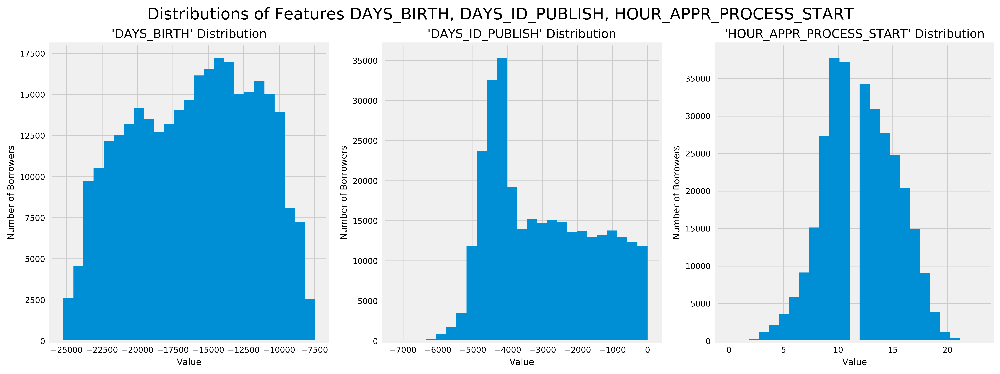

In [41]:
# Plot histogram of ['DAYS_BIRTH','DAYS_ID_PUBLISH','HOUR_APPR_PROCESS_START'], omitting any rows (borrowers) that have a value 
# of 'NaN' for the particular feature
vs.plot_feature_distributions(application_train_data[['DAYS_BIRTH','DAYS_ID_PUBLISH','HOUR_APPR_PROCESS_START']], title='Distributions of Features DAYS_BIRTH, DAYS_ID_PUBLISH, HOUR_APPR_PROCESS_START', figsize=(14,5), num_cols=3)


While all of these 22 features will need to be min-max scaled to a range of [0.0,1.0], the following three features already exhibit non-skewed, normal shaped distributions. It will not be necessary for them to be log-normalized: 
* `DAYS_BIRTH`
* `DAYS_ID_PUBLISH`
* `HOUR_APPR_PROCESS_START`

The rest of the features, especially those with majority of their values concentrated close to zero yet also having a smattering of large-valued data points, are good candidates for log-normalization. Doing this may prevent these features' very large and very small values from negatively affecting the performance of a learning algorithm.

There are three non-normalized features `DAYS_EMPLOYED`, `DAYS_REGISTRATION`, and `DAYS_LAST_PHONE_CHANGE` that both have skewed distributions, as well as values that fall inside a range of negative numbers. Because log-transformation cannot be run on negative values, these features' distributions would first need to be translated positively to the right, such that all their values are greater than or equal to zero. 

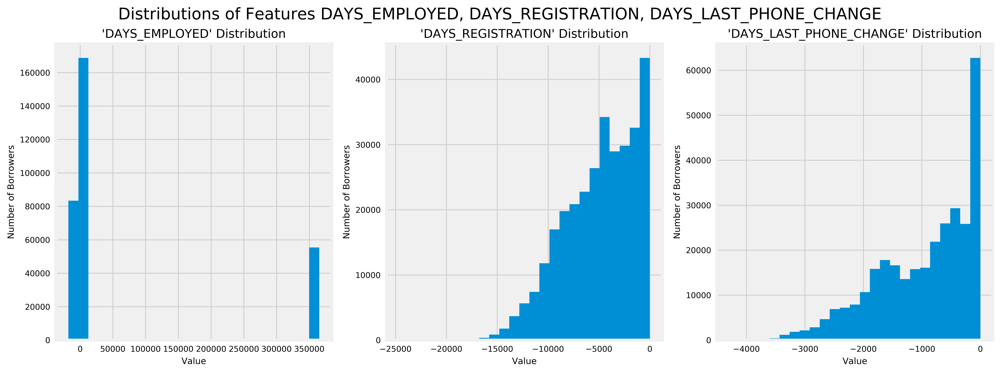

In [35]:
# Plot histogram of ['DAYS_EMPLOYED','DAYS_REGISTRATION','DAYS_LAST_PHONE_CHANGE'], omitting any rows (borrowers) that have skewed 
# distributions over a range of negative values.
vs.plot_feature_distributions(application_train_data[['DAYS_EMPLOYED','DAYS_REGISTRATION','DAYS_LAST_PHONE_CHANGE']], title='Distributions of Features DAYS_EMPLOYED, DAYS_REGISTRATION, DAYS_LAST_PHONE_CHANGE', figsize=(14,5), num_cols=3)


Unfortunately, `DAYS_EMPLOYED` and `OWN_CAR_AGE` contain an alarming amount of high-valued outliers that likely need to be addressed. I will further explore each of these features below.

### Deeper Dive into the `DAYS_EMPLOYED` Feature

I paid extra close attention to the histogram of `DAYS_EMPLOYED`, in order to observe whether it has other impossibly large, positive entries similar to the value of 365,243 days, or just over 1,000 years, that I observed above.

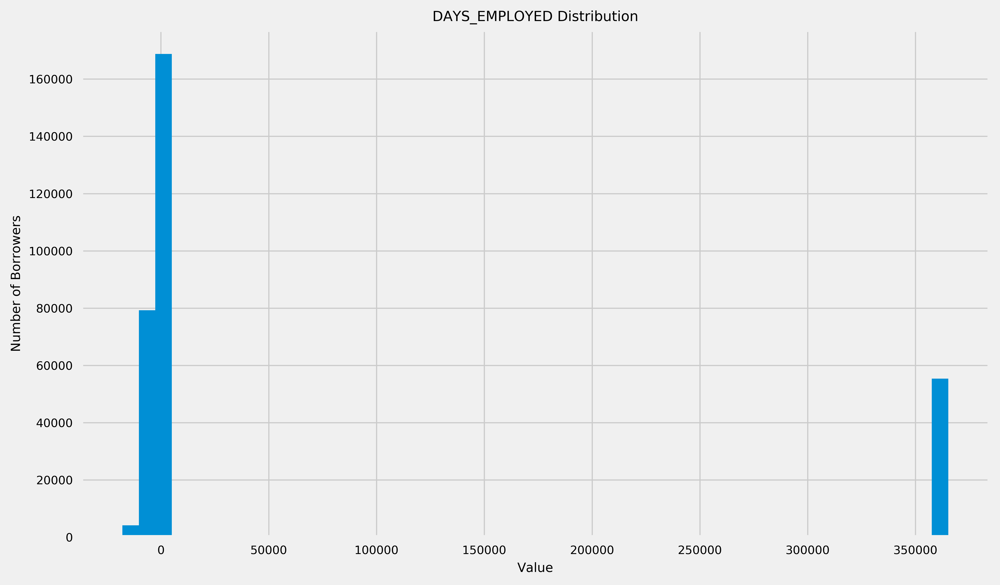

In [54]:
# Draw a larger plot of the DAYS_EMPLOYED feature's histogram
plt.figure(figsize = (10,6))
plt.hist(application_train_data['DAYS_EMPLOYED'], bins=50)
plt.title('DAYS_EMPLOYED Distribution')
plt.xlabel('Value')
plt.ylabel('Number of Borrowers')
plt.savefig('distribDAYSEMPLOYED.png')
plt.show()

In [66]:
application_train_data['DAYS_EMPLOYED'].value_counts().sort_index(ascending=False)

 365243    55374
 0             2
-1             1
-2             2
-3             3
-4             4
-5             1
-6             2
-7             1
-8             2
-9             3
-10            1
-11            2
-12            6
-13            3
-14            3
-15            6
-16            7
-17            5
-18            3
-19            3
-20            3
-21            2
-22            2
-23            1
-24            3
-25            3
-26            7
-27            2
-28            4
-29            5
-30            4
-31            8
-32            2
-33            2
-34            7
-35            3
-36            3
-37            5
-38           10
-39            2
-40            3
-41           12
-42           10
-43           13
-44            7
-45            6
-46           10
-47            4
-48            6
-49            9
-50            3
-51           10
-52            6
-53            6
-54           11
-55           10
-56           11
-57           

Based on the definition of `DAYS_EMPLOYED`, valid values should be in the range (-inf,0]. Unfortunately, 55,374 entries, or nearly one-sixth of the entire training dataset, has an entry of `365243` for this feature. Thankfully, `DAYS_EMPLOYED` has no 'NaN' entries. Were this value to be interpreted literally, it would indicate that one-sixth of the dataset got a job just over 1,000 years after submitting their loan applications to Home Credit.

This meaning is obviously absurd and there has to be another reason that so many borrowers had the value of `365243` entered for this feature. Since there were no instances of borrowers having a different non-zero positive value for this feature, my best guess is that `365243` was not meant to indicate a numerical value. I believe that this value was entered for applicants who did not have a job when they submitted their loan application to Home Credit. Since any negative integer or 0 would be a valid entry for this feature, and perhaps due to a data entry system's inability to accept any value besides an integer, I hypothesize that the original data enterers simply entered the largest positive integer that the system would accept in order to indicate that the applicant didn't have a job.

Intuitively, I can see that `DAYS_EMPLOYED` may well be a good predictor of target segments -- after all, if someone doesn't have a job, it stands to reason that there is a greater chance they won't have enough money to make loan payments on time. Unfortunately, I am not confident that the feature, as currently structured, would be able to adequately convey this information to a learning algorithm.

I propose to replace the `DAYS_EMPLOYED` feature with a new categorical feature called `HAS_JOB`. All individuals who have a value of `365243` for `DAYS_EMPLOYED` will be assigned a value of `0` for `HAS_JOB`. All individuals who have a value of 0 or less for `DAYS_EMPLOYED` will be assigned a value of `1` for `HAS_JOB`.

### Deeper Dive into the `OWN_CAR_AGE` Feature

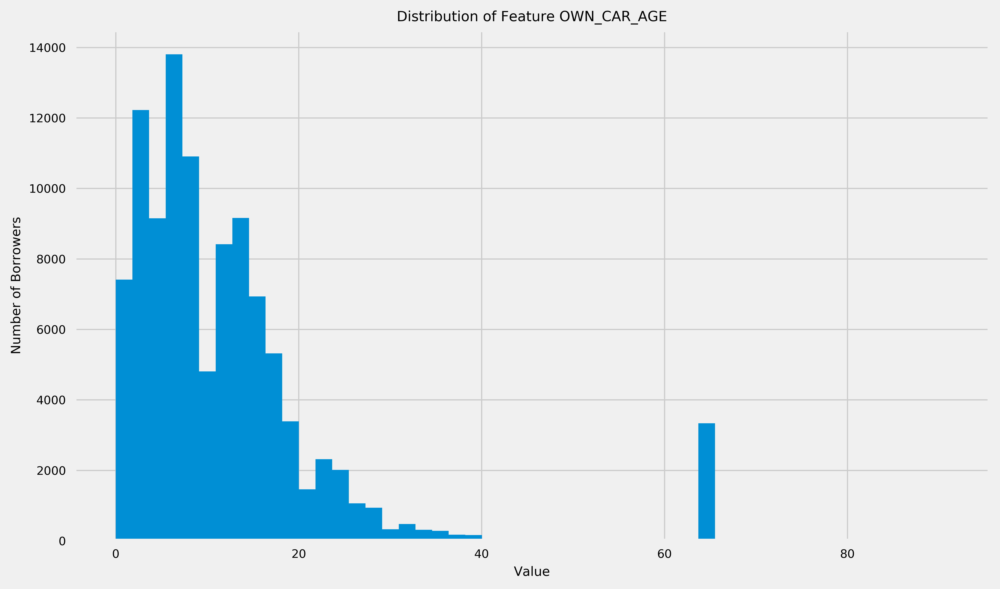

In [56]:
# Plot histogram of ['OWN_CAR_AGE'], omitting any rows (borrowers) that have a value 
# of 'NaN' for the particular feature
own_car_age_data = application_train_data['OWN_CAR_AGE']
filtered_own_car_age_data = own_car_age_data[~np.isnan(own_car_age_data)]
plt.figure(figsize = (10,6))
plt.hist(filtered_own_car_age_data, bins=50)
plt.title('Distribution of Feature OWN_CAR_AGE')
plt.xlabel('Value')
plt.ylabel('Number of Borrowers')
plt.savefig('distribOWNCARAGE.png')
plt.show()

There appear to be just under 4,000 borrowers who have a value for `OWN_CAR_AGE` that's between 60 and 70. This is far too many people to indicate anything but some sort of anomaly. The only kinds of cars that are still functional after 60+ years are collectible classic cars, and folks who apply for loans from Home Credit come from a far less well-off demographic than that which is associated with classic car collection.

In [40]:
application_train_data['OWN_CAR_AGE'].value_counts().sort_index(ascending=False)

91.0       2
69.0       1
65.0     891
64.0    2443
63.0       2
57.0       1
56.0       1
55.0       4
54.0      12
52.0       1
51.0       3
50.0       1
49.0       6
48.0       1
47.0       1
46.0       5
45.0      11
44.0      21
43.0      19
42.0      42
41.0      58
40.0      85
39.0      78
38.0      97
37.0      75
36.0     124
35.0     157
34.0     183
33.0     132
32.0     208
31.0     267
30.0     326
29.0     397
28.0     542
27.0     483
26.0     580
25.0     865
24.0    1150
23.0    1067
22.0    1250
21.0    1462
20.0    1527
19.0    1864
18.0    2418
17.0    2899
16.0    3355
15.0    3580
14.0    4594
13.0    4566
12.0    4257
11.0    4161
10.0    4806
9.0     5020
8.0     5887
7.0     7424
6.0     6382
5.0     3595
4.0     5557
3.0     6370
2.0     5852
1.0     5280
0.0     2134
Name: OWN_CAR_AGE, Length: 62, dtype: int64

Nonetheless, based on the unique value counts above, I can see right away that the distribution of `OWN_CAR_AGE` is less problematic than was the case for `DAYS_EMPLOYED`. There is at least a smooth decrease in numbers of users having older cars, right up until the anomalous spike. 

However, the distribution's pattern would indicate that I should expect only one or two borrowers each to have cars that are 64 and 65 years old. I can't hazard a reasonable guess that could explain why a total of 3,334 individuals have cars aged 64 or 65 years, and I can't formulate a compelling justification for removing these entries from the `OWN_CAR_AGE` feature. The good news is that this is probably ok. Since 3,334 borrowers is only just over 3% of the `OWN_CAR_AGE` feature's 104,582 valid non-'NaN' entries, log-normalizing this feature should be enough to counteract any negative effects that the anomalous spike may have on a learning algorithm.  

### Feature Engineering

`CNT_CHILDREN` will be transformed into a binary categorical feature called `HAS_CHILDREN`, with value of 1 if borrower has 0 children vs. a value of 1 if borrower has at least one child.

# 2. Bureau Data Table (`bureau.csv`)

In [10]:
# Display the first five records
display(bureau_data.head(n=5))

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.0,0.0,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.0,171342.0,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.5,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.0,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.0,NaN,NaN,0.0,Consumer credit,-21,NaN


**Bureau Data Table Featureset Definitions**

1. **SK_ID_CURR**: ID of loan in our sample - one loan in our sample can have 0,1,2 or more related previous credits in credit bureau -- hashed
* **SK_ID_BUREAU**: Recoded ID of previous Credit Bureau credit related to our loan (unique coding for each loan application) -- hashed
* **CREDIT_ACTIVE**: Status of the Credit Bureau (CB) reported credits - **CATEGORICAL**
* **CREDIT_CURRENCY**: Recoded currency of the Credit Bureau credit -- recoded - **CATEGORICAL**
* **DAYS_CREDIT**: How many days before current application did client apply for Credit Bureau credit -- time only relative to the application
* **CREDIT_DAY_OVERDUE**: Number of days past due on CB credit at the time of application for related loan in our sample	
* **DAYS_CREDIT_ENDDATE**: Remaining duration of CB credit (in days) at the time of application in Home Credit -- time only relative to the application
* **DAYS_ENDDATE_FACT**: Days since CB credit ended at the time of application in Home Credit (only for closed credit) -- time only relative to the application
* **AMT_CREDIT_MAX_OVERDUE**: Maximal amount overdue on the Credit Bureau credit so far (at application date of loan in our sample)	
* **CNT_CREDIT_PROLONG**: How many times was the Credit Bureau credit prolonged	
* **AMT_CREDIT_SUM**: Current credit amount for the Credit Bureau credit
* **AMT_CREDIT_SUM_DEBT**: Current debt on Credit Bureau credit	
* **AMT_CREDIT_SUM_LIMIT**: Current credit limit of credit card reported in Credit Bureau	
* **AMT_CREDIT_SUM_OVERDUE**: Current amount overdue on Credit Bureau credit	
* **CREDIT_TYPE**: Type of Credit Bureau credit (Car, cash,...) - **CATEGORICAL**
* **DAYS_CREDIT_UPDATE**: How many days before loan application did last information about the Credit Bureau credit come -- time only relative to the application
* **AMT_ANNUITY**: Annuity of the Credit Bureau credit	

### Categorical features in `bureau.csv`

```
'CREDIT_ACTIVE', 'CREDIT_CURRENCY', 'CREDIT_TYPE'
```

In [50]:
display(bureau_data.nunique())

SK_ID_CURR                 305811
SK_ID_BUREAU              1716428
CREDIT_ACTIVE                   4
CREDIT_CURRENCY                 4
DAYS_CREDIT                  2923
CREDIT_DAY_OVERDUE            942
DAYS_CREDIT_ENDDATE         14096
DAYS_ENDDATE_FACT            2917
AMT_CREDIT_MAX_OVERDUE      68251
CNT_CREDIT_PROLONG             10
AMT_CREDIT_SUM             236708
AMT_CREDIT_SUM_DEBT        226537
AMT_CREDIT_SUM_LIMIT        51726
AMT_CREDIT_SUM_OVERDUE       1616
CREDIT_TYPE                    15
DAYS_CREDIT_UPDATE           2982
AMT_ANNUITY                 40321
Length: 17, dtype: int64

### Plot the 12 numerical features in `bureau.csv`:

```
 'DAYS_CREDIT', 'CREDIT_DAY_OVERDUE', 'DAYS_CREDIT_ENDDATE',
 'DAYS_ENDDATE_FACT', 'AMT_CREDIT_MAX_OVERDUE', 'CNT_CREDIT_PROLONG',
 'AMT_CREDIT_SUM', 'AMT_CREDIT_SUM_DEBT', 'AMT_CREDIT_SUM_LIMIT',
 'AMT_CREDIT_SUM_OVERDUE', 'DAYS_CREDIT_UPDATE', 'AMT_ANNUITY'
```

In [22]:
# List of bureau data table numerical features
bureau_data_numerical_feats = [
 'DAYS_CREDIT', 'CREDIT_DAY_OVERDUE', 'DAYS_CREDIT_ENDDATE',
 'DAYS_ENDDATE_FACT', 'AMT_CREDIT_MAX_OVERDUE', 'CNT_CREDIT_PROLONG',
 'AMT_CREDIT_SUM', 'AMT_CREDIT_SUM_DEBT', 'AMT_CREDIT_SUM_LIMIT',
 'AMT_CREDIT_SUM_OVERDUE', 'DAYS_CREDIT_UPDATE', 'AMT_ANNUITY'   
]

# Plot histogram of each normalized feature, omitting any rows (borrowers) that have a value 
# of 'NaN' for the particular feature
vs.plot_feature_distributions(bureau_data[bureau_data_numerical_feats], 
                              title='Distributions of Bureau Data Table\'s Numerical Features', figsize=(14,16), 
                              num_cols=3)


### Feature Engineering

My new feature will be titled `HAS_CREDIT_BUREAU_LOANS_OVERDUE`. If a Home Credit applicant has at least one loan in `bureau.csv` for which `CREDIT_DAY_OVERDUE` has a value greater than 0, the value of my new feature in the row belonging to that applicant's Home Credit borrower ID will be 1. Otherwise, the value will be 0. I will engineer this feature during the data preprocessing phase, and once it has been created I will append it to the main data table.

# 3. Bureau Balance Data Table (`bureau_balance.csv`)

In [12]:
# Display the first five records
display(bureau_balance_data.head(n=5))

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


**Bureau Balance Data Table Featureset Definitions**

1. **SK_ID_BUREAU**: Recoded ID of Credit Bureau credit (unique coding for each application) - use this to join to CREDIT_BUREAU table -- hashed
* **MONTHS_BALANCE**: Month of balance relative to application date (-1 means the freshest balance date) -- time only relative to the application
* **STATUS**: Status of Credit Bureau loan during the month (active, closed, DPD0-30,Ö [C means closed, X means status unknown, 0 means no DPD, 1 means maximal did during month between 1-30, 2 means DPD 31-60,Ö 5 means DPD 120+ or sold or written off ])

In [31]:
# Sort by loan ID, then by month balance
display(bureau_balance_data.sort_values(by=['SK_ID_BUREAU', 'MONTHS_BALANCE']))

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
26079849,5001709,-96,X
26079848,5001709,-95,X
26079847,5001709,-94,X
26079846,5001709,-93,X
26079845,5001709,-92,X
26079844,5001709,-91,X
26079843,5001709,-90,X
26079842,5001709,-89,X
26079841,5001709,-88,X
26079840,5001709,-87,X


In [32]:
# Use the SK_ID_CURR and SK_ID_BUREAU columns in bureau data table as key in 
# order to add an SK_ID_CURR column to features built from the bureau balance table
bureau_table_SK_ID_CURR_and_SK_ID_BUREAU = bureau_data[['SK_ID_CURR', 'SK_ID_BUREAU']]

# There are 1716428 unique SK_ID_BUREAU values in the bureau data table. 
# There are 817395 unique SK_ID_BUREAU values in the bureau balance data table.
# However, there are 43041 SK_ID_BUREAU values in the bureau balance data table, 
# which are **not** in the bureau data table. This means there are no corresponding 
# SK_ID_CURR ids that can be associated with these 43041 entries.
# Thus, after joining a column containing SK_ID_CURR values to the bureau balance 
# data table features, there should be 817395 - 43041 = 774354 unique SK_ID_BUREAU 
# values in the resulting table.

print('Bureau Data Table unique SK_ID_BUREAU values:')
print(bureau_table_SK_ID_CURR_and_SK_ID_BUREAU['SK_ID_BUREAU'].nunique())
print('Bureau Balance Data Table unique SK_ID_BUREAU values:')
print(bureau_balance_data['SK_ID_BUREAU'].nunique())
print('Unique SK_ID_BUREAU values in both Bureau Data Table and Bureau Balance Data Table:')
print(pd.Series(list(set(bureau_table_SK_ID_CURR_and_SK_ID_BUREAU['SK_ID_BUREAU']).intersection(set(bureau_balance_data['SK_ID_BUREAU'])))).shape[0])


Bureau Data Table unique SK_ID_BUREAU values:
1716428
Bureau Balance Data Table unique SK_ID_BUREAU values:
817395
Unique SK_ID_BUREAU values in both Bureau Data Table and Bureau Balance Data Table:
774354


In [40]:
# There are eight possible values for 'STATUS':
# C, X, 0, 1, 2, 3, 4, 5

bureau_balance_data['STATUS'].value_counts()

C    13646993
0     7499507
X     5810482
1      242347
5       62406
2       23419
3        8924
4        5847
Name: STATUS, Length: 8, dtype: int64

# 4. Previous Application Data Table (`previous_application.csv`)

In [13]:
# Display the first five records
display(previous_application_data.head(n=5))


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


**Previous Application Data Table Featureset Definitions**

1. **SK_ID_PREV**: ID of previous credit in Home credit related to loan in our sample. (One loan in our sample can have 0,1,2 or more previous loan applications in Home Credit, previous application could, but not necessarily have to lead to credit) -- hashed
* **SK_ID_CURR**: ID of loan in our sample -- hashed
* **NAME_CONTRACT_TYPE**: Contract product type (Cash loan, consumer loan [POS] ,...) of the previous application	
* **AMT_ANNUITY**: Annuity of previous application	
* **AMT_APPLICATION**: For how much credit did client ask on the previous application	
* **AMT_CREDIT**: Final credit amount on the previous application. This differs from AMT_APPLICATION in a way that the AMT_APPLICATION is the amount for which the client initially applied for, but during our approval process he could have received different amount - AMT_CREDIT	
* **AMT_DOWN_PAYMENT**: Down payment on the previous application	
* **AMT_GOODS_PRICE**: Goods price of good that client asked for (if applicable) on the previous application	
* **WEEKDAY_APPR_PROCESS_START**: On which day of the week did the client apply for previous application	
* **HOUR_APPR_PROCESS_START**: Approximately at what day hour did the client apply for the previous application -- rounded
* **FLAG_LAST_APPL_PER_CONTRACT**: Flag if it was last application for the previous contract. Sometimes by mistake of client or our clerk there could be more applications for one single contract	
* **NFLAG_LAST_APPL_IN_DAY**: Flag if the application was the last application per day of the client. Sometimes clients apply for more applications a day. Rarely it could also be error in our system that one application is in the database twice	
* **RATE_DOWN_PAYMENT**: Down payment rate normalized on previous credit -- normalized
* **RATE_INTEREST_PRIMARY**: Interest rate normalized on previous credit -- normalized
* **RATE_INTEREST_PRIVILEGED**: Interest rate normalized on previous credit -- normalized
* **NAME_CASH_LOAN_PURPOSE**: Purpose of the cash loan	
* **NAME_CONTRACT_STATUS**: Contract status (approved, cancelled, ...) of previous application	
* **DAYS_DECISION**: Relative to current application when was the decision about previous application made	time only relative to the application
* **NAME_PAYMENT_TYPE**: Payment method that client chose to pay for the previous application	
* **CODE_REJECT_REASON**: Why was the previous application rejected	
* **NAME_TYPE_SUITE**: Who accompanied client when applying for the previous application	
* **NAME_CLIENT_TYPE**: Was the client old or new client when applying for the previous application	
* **NAME_GOODS_CATEGORY**: What kind of goods did the client apply for in the previous application	
* **NAME_PORTFOLIO**: Was the previous application for CASH, POS, CAR, Ö
* **NAME_PRODUCT_TYPE**: Was the previous application x-sell o walk-in	
* **CHANNEL_TYPE**: Through which channel we acquired the client on the previous application	
* **SELLERPLACE_AREA**: Selling area of seller place of the previous application	
* **NAME_SELLER_INDUSTRY**: The industry of the seller	
* **CNT_PAYMENT**: Term of previous credit at application of the previous application	
* **NAME_YIELD_GROUP**: Grouped interest rate into small medium and high of the previous application -- grouped
* **PRODUCT_COMBINATION**: Detailed product combination of the previous application	
* **DAYS_FIRST_DRAWING**: Relative to application date of current application when was the first disbursement of the previous application -- time only relative to the application
* **DAYS_FIRST_DUE**: Relative to application date of current application when was the first due supposed to be of the previous application -- time only relative to the application
* **DAYS_LAST_DUE_1ST_VERSION**: Relative to application date of current application when was the first due of the previous application -- time only relative to the application
* **DAYS_LAST_DUE**: Relative to application date of current application when was the last due date of the previous application -- time only relative to the application
* **DAYS_TERMINATION**: Relative to application date of current application when was the expected termination of the previous application -- time only relative to the application
* **NFLAG_INSURED_ON_APPROVAL**: Did the client requested insurance during the previous application

In [49]:
display(previous_application_data.nunique())

SK_ID_PREV                     1670214
SK_ID_CURR                      338857
NAME_CONTRACT_TYPE                   4
AMT_ANNUITY                     357959
AMT_APPLICATION                  93885
AMT_CREDIT                       86803
AMT_DOWN_PAYMENT                 29278
AMT_GOODS_PRICE                  93885
WEEKDAY_APPR_PROCESS_START           7
HOUR_APPR_PROCESS_START             24
FLAG_LAST_APPL_PER_CONTRACT          2
NFLAG_LAST_APPL_IN_DAY               2
RATE_DOWN_PAYMENT               207033
RATE_INTEREST_PRIMARY              148
RATE_INTEREST_PRIVILEGED            25
NAME_CASH_LOAN_PURPOSE              25
NAME_CONTRACT_STATUS                 4
DAYS_DECISION                     2922
NAME_PAYMENT_TYPE                    4
CODE_REJECT_REASON                   9
NAME_TYPE_SUITE                      7
NAME_CLIENT_TYPE                     4
NAME_GOODS_CATEGORY                 28
NAME_PORTFOLIO                       5
NAME_PRODUCT_TYPE                    3
CHANNEL_TYPE             

### 18 Categorical features in `previous_application.csv`

```
'NAME_CONTRACT_TYPE',
'WEEKDAY_APPR_PROCESS_START', 
'FLAG_LAST_APPL_PER_CONTRACT', 
'NFLAG_LAST_APPL_IN_DAY',
'NAME_CASH_LOAN_PURPOSE',
'NAME_CONTRACT_STATUS', 
'NAME_PAYMENT_TYPE',
'CODE_REJECT_REASON',  
'NAME_TYPE_SUITE',   
'NAME_CLIENT_TYPE',
'NAME_GOODS_CATEGORY', 
'NAME_PORTFOLIO', 
'NAME_PRODUCT_TYPE',
'CHANNEL_TYPE',                         
'NAME_SELLER_INDUSTRY', 
'NAME_YIELD_GROUP', 
'PRODUCT_COMBINATION',
'NFLAG_INSURED_ON_APPROVAL' 
```

### Plot the 17 numerical features in `previous_application.csv`:

```
  'AMT_ANNUITY', 'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_DOWN_PAYMENT', 
  'AMT_GOODS_PRICE', 'HOUR_APPR_PROCESS_START', 'RATE_DOWN_PAYMENT', 'RATE_INTEREST_PRIMARY',   
  'RATE_INTEREST_PRIVILEGED', 'DAYS_DECISION', 'SELLERPLACE_AREA', 'CNT_PAYMENT',
  'DAYS_FIRST_DRAWING', 'DAYS_FIRST_DUE', 'DAYS_LAST_DUE_1ST_VERSION', 'DAYS_LAST_DUE',
  'DAYS_TERMINATION'
```

In [23]:
# List of previous application data table numerical features
previous_app_data_numerical_feats = [
 'AMT_ANNUITY', 'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_DOWN_PAYMENT', 
 'AMT_GOODS_PRICE', 'HOUR_APPR_PROCESS_START', 'RATE_DOWN_PAYMENT', 'RATE_INTEREST_PRIMARY',   
 'RATE_INTEREST_PRIVILEGED', 'DAYS_DECISION', 'SELLERPLACE_AREA', 'CNT_PAYMENT',
 'DAYS_FIRST_DRAWING', 'DAYS_FIRST_DUE', 'DAYS_LAST_DUE_1ST_VERSION', 'DAYS_LAST_DUE',
 'DAYS_TERMINATION'   
]

# Plot histogram of each normalized feature, omitting any rows (borrowers) that have a value 
# of 'NaN' for the particular feature
vs.plot_feature_distributions(previous_application_data[previous_app_data_numerical_feats], 
                              title='Distributions of Previous Application Data Table\'s Numerical Features', figsize=(14,18), 
                              num_cols=3)

# 5. POS CASH Balance Data Table (`POS_CASH_balance.csv`)

In [14]:
# Display the first five records
display(POS_CASH_balance_data.head(n=5))

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.0,45.0,Active,0,0
1,1715348,367990,-33,36.0,35.0,Active,0,0
2,1784872,397406,-32,12.0,9.0,Active,0,0
3,1903291,269225,-35,48.0,42.0,Active,0,0
4,2341044,334279,-35,36.0,35.0,Active,0,0


**POS CASH Balance Data Table Featureset Definitions**

1. **SK_ID_PREV**: ID of previous credit in Home Credit related to loan in our sample. (One loan in our sample can have 0,1,2 or more previous loans in Home Credit)	
* **SK_ID_CURR**: ID of loan in our sample	
* **MONTHS_BALANCE**: Month of balance relative to application date (-1 means the information to the freshest monthly snapshot, 0 means the information at application - often it will be the same as -1 as many banks are not updating the information to Credit Bureau regularly ) -- time only relative to the application
* **CNT_INSTALMENT**: Term of previous credit (can change over time)	
* **CNT_INSTALMENT_FUTURE**: Installments left to pay on the previous credit	
* **NAME_CONTRACT_STATUS**: Contract status during the month	
* **SK_DPD**: DPD (days past due) during the month of previous credit	
* **SK_DPD_DEF**: DPD during the month with tolerance (debts with low loan amounts are ignored) of the previous credit

In [29]:
# Sort by borrower ID, then by previous loan ID, then by month balance
display(POS_CASH_balance_data.sort_values(by=['SK_ID_CURR', 'SK_ID_PREV', 'MONTHS_BALANCE']))

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
7167007,1369693,100001,-57,4.0,4.0,Active,0,0
8789081,1369693,100001,-56,4.0,3.0,Active,0,0
7823681,1369693,100001,-55,4.0,2.0,Active,0,0
4704415,1369693,100001,-54,4.0,1.0,Active,0,0
2197888,1369693,100001,-53,4.0,0.0,Completed,0,0
1261679,1851984,100001,-96,4.0,2.0,Active,0,0
1891462,1851984,100001,-95,4.0,1.0,Active,7,7
8531326,1851984,100001,-94,4.0,0.0,Active,0,0
4928574,1851984,100001,-93,4.0,0.0,Completed,0,0
8473918,1038818,100002,-19,24.0,24.0,Active,0,0


In [4]:
display(POS_CASH_balance_data.nunique())

SK_ID_PREV               936325
SK_ID_CURR               337252
MONTHS_BALANCE               96
CNT_INSTALMENT               73
CNT_INSTALMENT_FUTURE        79
NAME_CONTRACT_STATUS          9
SK_DPD                     3400
SK_DPD_DEF                 2307
Length: 8, dtype: int64

In [5]:
display(POS_CASH_balance_data['NAME_CONTRACT_STATUS'].value_counts())

Active                   9151119
Completed                 744883
Signed                     87260
Demand                      7065
Returned to the store       5461
Approved                    4917
Amortized debt               636
Canceled                      15
XNA                            2
Name: NAME_CONTRACT_STATUS, Length: 9, dtype: int64

# 6. Installments Payments Data Table (`installments_payments.csv`)

In [15]:
# Display the first five records
display(installments_payments_data.head(n=5))

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.0,6,-1180.0,-1187.0,6948.360,6948.360
1,1330831,151639,0.0,34,-2156.0,-2156.0,1716.525,1716.525
2,2085231,193053,2.0,1,-63.0,-63.0,25425.000,25425.000
3,2452527,199697,1.0,3,-2418.0,-2426.0,24350.130,24350.130
4,2714724,167756,1.0,2,-1383.0,-1366.0,2165.040,2160.585


**Installments Payments Data Table Featureset Definitions**

1. **SK_ID_PREV**: ID of previous credit in Home credit related to loan in our sample. (One loan in our sample can have 0,1,2 or more previous loans in Home Credit) -- hashed
* **SK_ID_CURR**: ID of loan in our sample -- hashed
* **NUM_INSTALMENT_VERSION**: Version of installment calendar (0 is for credit card) of previous credit. Change of installment version from month to month signifies that some parameter of payment calendar has changed	
* **NUM_INSTALMENT_NUMBER**: On which installment we observe payment	
* **DAYS_INSTALMENT**: When the installment of previous credit was supposed to be paid (relative to application date of current loan) -- time only relative to the application
* **DAYS_ENTRY_PAYMENT**: When was the installments of previous credit paid actually (relative to application date of current loan) -- time only relative to the application
* **AMT_INSTALMENT**: What was the prescribed installment amount of previous credit on this installment	
* **AMT_PAYMENT**: What the client actually paid on previous credit on this installment

### Plot the 5 numerical features in `installments_payments.csv`:

```
  'NUM_INSTALMENT_NUMBER', 'DAYS_INSTALMENT', 'DAYS_ENTRY_PAYMENT', 
  'AMT_INSTALMENT', 'AMT_PAYMENT'
```

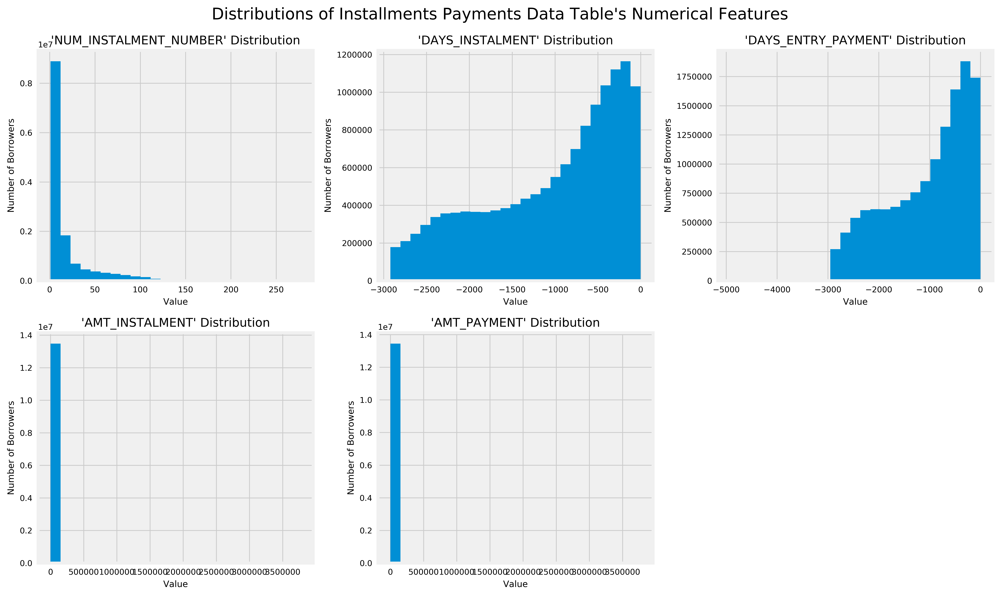

In [25]:
# List of installments payments data table numerical features
install_pay_data_numerical_feats = [
 'NUM_INSTALMENT_NUMBER', 'DAYS_INSTALMENT', 'DAYS_ENTRY_PAYMENT', 
  'AMT_INSTALMENT', 'AMT_PAYMENT'  
]

# Plot histogram of each normalized feature, omitting any rows (borrowers) that have a value 
# of 'NaN' for the particular feature
vs.plot_feature_distributions(installments_payments_data[install_pay_data_numerical_feats], 
                              title='Distributions of Installments Payments Data Table\'s Numerical Features', figsize=(14,8), 
                              num_cols=3)

In [42]:
# Sort by borrower ID, then by loan ID, then by month balance
display(installments_payments_data.sort_values(by=['SK_ID_CURR', 'SK_ID_PREV', 'NUM_INSTALMENT_NUMBER']))

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
1478621,1369693,100001,1.0,1,-1709.0,-1715.0,3951.000,3951.000
2568722,1369693,100001,1.0,2,-1679.0,-1715.0,3951.000,3951.000
3458712,1369693,100001,1.0,3,-1649.0,-1660.0,3951.000,3951.000
2624024,1369693,100001,2.0,4,-1619.0,-1628.0,17397.900,17397.900
1761012,1851984,100001,1.0,2,-2916.0,-2916.0,3982.050,3982.050
3774071,1851984,100001,1.0,3,-2886.0,-2875.0,3982.050,3982.050
3435373,1851984,100001,1.0,4,-2856.0,-2856.0,3980.925,3980.925
2144879,1038818,100002,1.0,1,-565.0,-587.0,9251.775,9251.775
2163032,1038818,100002,1.0,2,-535.0,-562.0,9251.775,9251.775
1675768,1038818,100002,1.0,3,-505.0,-529.0,9251.775,9251.775


In [43]:
display(installments_payments_data.nunique())

SK_ID_PREV                997752
SK_ID_CURR                339587
NUM_INSTALMENT_VERSION        65
NUM_INSTALMENT_NUMBER        277
DAYS_INSTALMENT             2922
DAYS_ENTRY_PAYMENT          3039
AMT_INSTALMENT            902539
AMT_PAYMENT               944235
Length: 8, dtype: int64

In [46]:
test = installments_payments_data[installments_payments_data['SK_ID_CURR'] == 151639]

underpayments = test['AMT_INSTALMENT'] - test['AMT_PAYMENT']

In [48]:
display(underpayments.sum())

124395.48000000003

# 7. Credit Card Balance Data Table (`credit_card_balance.csv`)

In [16]:
# Display the first five records
display(credit_card_balance_data.head(n=5))

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.970,135000,0.0,877.5,0.0,877.5,1700.325,1800.0,1800.0,0.000,0.000,0.000,0.0,1,0.0,1.0,35.0,Active,0,0
1,2582071,363914,-1,63975.555,45000,2250.0,2250.0,0.0,0.0,2250.000,2250.0,2250.0,60175.080,64875.555,64875.555,1.0,1,0.0,0.0,69.0,Active,0,0
2,1740877,371185,-7,31815.225,450000,0.0,0.0,0.0,0.0,2250.000,2250.0,2250.0,26926.425,31460.085,31460.085,0.0,0,0.0,0.0,30.0,Active,0,0
3,1389973,337855,-4,236572.110,225000,2250.0,2250.0,0.0,0.0,11795.760,11925.0,11925.0,224949.285,233048.970,233048.970,1.0,1,0.0,0.0,10.0,Active,0,0
4,1891521,126868,-1,453919.455,450000,0.0,11547.0,0.0,11547.0,22924.890,27000.0,27000.0,443044.395,453919.455,453919.455,0.0,1,0.0,1.0,101.0,Active,0,0


**Credit Card Balance Data Table Featureset Definitions**

1. **SK_ID_PREV**: ID of previous credit in Home credit related to loan in our sample. (One loan in our sample can have 0,1,2 or more previous loans in Home Credit) -- hashed
* **SK_ID_CURR**: ID of loan in our sample -- hashed
* **MONTHS_BALANCE**: Month of balance relative to application date (-1 means the freshest balance date) -- time only relative to the application
* **AMT_BALANCE**: Balance during the month of previous credit	
* **AMT_CREDIT_LIMIT_ACTUAL**: Credit card limit during the month of the previous credit	
* **AMT_DRAWINGS_ATM_CURRENT**: Amount drawing at ATM during the month of the previous credit	
* **AMT_DRAWINGS_CURRENT**: Amount drawing during the month of the previous credit	
* **AMT_DRAWINGS_OTHER_CURRENT**: Amount of other drawings during the month of the previous credit	
* **AMT_DRAWINGS_POS_CURRENT**: Amount drawing or buying goods during the month of the previous credit	
* **AMT_INST_MIN_REGULARITY**: Minimal installment for this month of the previous credit	
* **AMT_PAYMENT_CURRENT**: How much did the client pay during the month on the previous credit	
* **AMT_PAYMENT_TOTAL_CURRENT**: How much did the client pay during the month in total on the previous credit	
* **AMT_RECEIVABLE_PRINCIPAL**: Amount receivable for principal on the previous credit	
* **AMT_RECIVABLE**: Amount receivable on the previous credit	
* **AMT_TOTAL_RECEIVABLE**: Total amount receivable on the previous credit
* **CNT_DRAWINGS_ATM_CURRENT**: Number of drawings at ATM during this month on the previous credit	
* **CNT_DRAWINGS_CURRENT**: Number of drawings during this month on the previous credit	
* **CNT_DRAWINGS_OTHER_CURRENT**: Number of other drawings during this month on the previous credit	
* **CNT_DRAWINGS_POS_CURRENT**: Number of drawings for goods during this month on the previous credit	
* **CNT_INSTALMENT_MATURE_CUM**: Number of paid installments on the previous credit	
* **NAME_CONTRACT_STATUS**: Contract status (active signed,...) on the previous credit	
* **SK_DPD**: DPD (Days past due) during the month on the previous credit
* **SK_DPD_DEF**: DPD (Days past due) during the month with tolerance (debts with low loan amounts are ignored) of the previous credit

In [26]:
# Sort by borrower ID, then by credit card loan ID, then by month balance
display(credit_card_balance_data.sort_values(by=['SK_ID_CURR', 'SK_ID_PREV', 'MONTHS_BALANCE']))


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
1636141,1489396,100006,-6,0.000,270000,NaN,0.000,NaN,NaN,0.000,NaN,0.000,0.000,0.000,0.000,NaN,0,NaN,NaN,0.0,Active,0,0
655566,1489396,100006,-5,0.000,270000,NaN,0.000,NaN,NaN,0.000,NaN,0.000,0.000,0.000,0.000,NaN,0,NaN,NaN,0.0,Active,0,0
1399895,1489396,100006,-4,0.000,270000,NaN,0.000,NaN,NaN,0.000,NaN,0.000,0.000,0.000,0.000,NaN,0,NaN,NaN,0.0,Active,0,0
1347528,1489396,100006,-3,0.000,270000,NaN,0.000,NaN,NaN,0.000,NaN,0.000,0.000,0.000,0.000,NaN,0,NaN,NaN,0.0,Active,0,0
520387,1489396,100006,-2,0.000,270000,NaN,0.000,NaN,NaN,0.000,NaN,0.000,0.000,0.000,0.000,NaN,0,NaN,NaN,0.0,Active,0,0
584804,1489396,100006,-1,0.000,270000,NaN,0.000,NaN,NaN,0.000,NaN,0.000,0.000,0.000,0.000,NaN,0,NaN,NaN,0.0,Active,0,0
3131464,1843384,100011,-75,189000.000,180000,180000.0,180000.000,0.0,0.000,NaN,0.000,0.000,180000.000,189000.000,189000.000,4.0,4,0.0,0.0,NaN,Active,0,0
2447092,1843384,100011,-74,184568.850,180000,0.0,0.000,0.0,0.000,9000.000,9000.000,9000.000,180000.000,184568.850,184568.850,0.0,0,0.0,0.0,1.0,Active,0,0
2353190,1843384,100011,-73,181044.540,180000,0.0,0.000,0.0,0.000,9000.000,9000.000,9000.000,175568.850,181044.540,181044.540,0.0,0,0.0,0.0,2.0,Active,0,0
1086495,1843384,100011,-72,177544.350,180000,0.0,0.000,0.0,0.000,9000.000,9000.000,9000.000,172044.540,177544.350,177544.350,0.0,0,0.0,0.0,3.0,Active,0,0


In [3]:
display(credit_card_balance_data.nunique())

SK_ID_PREV                     104307
SK_ID_CURR                     103558
MONTHS_BALANCE                     96
AMT_BALANCE                   1347904
AMT_CREDIT_LIMIT_ACTUAL           181
AMT_DRAWINGS_ATM_CURRENT         2267
AMT_DRAWINGS_CURRENT           187005
AMT_DRAWINGS_OTHER_CURRENT       1832
AMT_DRAWINGS_POS_CURRENT       168748
AMT_INST_MIN_REGULARITY        312266
AMT_PAYMENT_CURRENT            163209
AMT_PAYMENT_TOTAL_CURRENT      182957
AMT_RECEIVABLE_PRINCIPAL      1195839
AMT_RECIVABLE                 1338878
AMT_TOTAL_RECEIVABLE          1339008
CNT_DRAWINGS_ATM_CURRENT           44
CNT_DRAWINGS_CURRENT              129
CNT_DRAWINGS_OTHER_CURRENT         11
CNT_DRAWINGS_POS_CURRENT          133
CNT_INSTALMENT_MATURE_CUM         121
NAME_CONTRACT_STATUS                7
SK_DPD                            917
SK_DPD_DEF                        378
Length: 23, dtype: int64

### Plot the 14 numerical features in `credit_card_balance.csv` that don't vary by month:

```
'AMT_CREDIT_LIMIT_ACTUAL', 
'AMT_DRAWINGS_ATM_CURRENT', 
'AMT_DRAWINGS_CURRENT', 
'AMT_DRAWINGS_OTHER_CURRENT', 
'AMT_DRAWINGS_POS_CURRENT', 
'AMT_INST_MIN_REGULARITY', 
'AMT_PAYMENT_CURRENT', 
'AMT_PAYMENT_TOTAL_CURRENT', 
'CNT_DRAWINGS_ATM_CURRENT', 
'CNT_DRAWINGS_CURRENT', 
'CNT_DRAWINGS_OTHER_CURRENT',
'CNT_DRAWINGS_POS_CURRENT', 
'SK_DPD', 
'SK_DPD_DEF'
```

In [28]:
# List of credit card balance data table numerical features that don't vary by month
cc_num_feat_not_vary_by_month = [
 'AMT_CREDIT_LIMIT_ACTUAL', 'AMT_DRAWINGS_ATM_CURRENT', 'AMT_DRAWINGS_CURRENT', 'AMT_DRAWINGS_OTHER_CURRENT', 
'AMT_DRAWINGS_POS_CURRENT', 'AMT_INST_MIN_REGULARITY', 'AMT_PAYMENT_CURRENT', 'AMT_PAYMENT_TOTAL_CURRENT', 
'CNT_DRAWINGS_ATM_CURRENT', 'CNT_DRAWINGS_CURRENT', 'CNT_DRAWINGS_OTHER_CURRENT', 'CNT_DRAWINGS_POS_CURRENT', 
'SK_DPD', 'SK_DPD_DEF' 
]

# Plot histogram of each normalized feature, omitting any rows (borrowers) that have a value 
# of 'NaN' for the particular feature
vs.plot_feature_distributions(credit_card_balance_data[cc_num_feat_not_vary_by_month], 
                              title='Distributions of Credit Card Balance Data Table\'s Numerical Features that don\'t vary by month', figsize=(14,16), 
                              num_cols=3)

In [41]:
# Value counts for the 'NAME_CONTRACT_STATUS' feature
display(credit_card_balance_data['NAME_CONTRACT_STATUS'].value_counts())

Active           3698436
Completed         128918
Signed             11058
Demand              1365
Sent proposal        513
Refused               17
Approved               5
Name: NAME_CONTRACT_STATUS, Length: 7, dtype: int64

## 8. Exploration of loans ('SK_ID_PREV') in `previous_application.csv`, 
## `POS_CASH_balance.csv`, `installments_payments.csv`, and 
## `credit_card_balance.csv` Tables

To what extent are these tables talking about the same loans?

In [ ]:
previous_application_data['SK_ID_PREV']
installments_payments_data['SK_ID_PREV']
POS_CASH_balance_data['SK_ID_PREV']
credit_card_balance_data['SK_ID_PREV']

In [99]:
unique_credit_card_loan_IDs = credit_card_balance_data['SK_ID_PREV'].drop_duplicates()
unique_POS_CASH_BALANCE_loan_IDs = POS_CASH_balance_data['SK_ID_PREV'].drop_duplicates()
unique_installments_payments_loan_IDs = installments_payments_data['SK_ID_PREV'].drop_duplicates()
unique_previous_application_loan_IDs = previous_application_data['SK_ID_PREV'].drop_duplicates()

In [108]:
display(unique_credit_card_loan_IDs.isin(unique_previous_application_loan_IDs).value_counts())

True     92935
False    11372
Name: SK_ID_PREV, Length: 2, dtype: int64

In [109]:
display(unique_credit_card_loan_IDs.isin(unique_installments_payments_loan_IDs).value_counts())

True     72466
False    31841
Name: SK_ID_PREV, Length: 2, dtype: int64

In [110]:
display(unique_credit_card_loan_IDs.isin(unique_POS_CASH_BALANCE_loan_IDs).value_counts())

False    104307
Name: SK_ID_PREV, Length: 1, dtype: int64

In [111]:
display(unique_POS_CASH_BALANCE_loan_IDs.isin(unique_previous_application_loan_IDs).value_counts())

True     898903
False     37422
Name: SK_ID_PREV, Length: 2, dtype: int64

In [112]:
display(unique_POS_CASH_BALANCE_loan_IDs.isin(unique_installments_payments_loan_IDs).value_counts())

True     924949
False     11376
Name: SK_ID_PREV, Length: 2, dtype: int64

Conclusion:

The POS_Balance_data table and credit_card_balance data tables contain two mutually exlusive sets of loans -- there is no overlap between the loan IDs (SK_ID_PREV) in each of these tables.

Most, but not all of the loans in both the POS_Balance_data table and credit_card_balance data tables have information about their initial applications and installments payments in the previous_application_data and installments_payments_data tables, respectively.